#**GEOSHIELD:A MACHINE LEARNING APPROACH TO PIPELINE RISK ASSESSMENT IN KENYA**

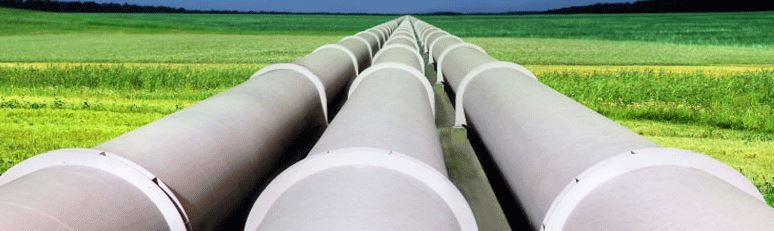

---



In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive



#**1.BUSINESS UNDERSTANDING**

##**1.1 INTRODUCTION**
This project assesses the risk of pipeline segments in Kenya based on their proximity to populated settlements,transport infrastructure and ecological sight, aiming to identify High-Consequence Areas (HCAs) that may require enhanced safety measures or regulatory compliance.

###**1.2 PROBLEM STATEMENT**

Modern pipeline infrastructure is critical to energy distribution, but it increasingly faces significant operational risks — including environmental, human, and financial threats — due to aging assets, expanding urbanization, and complex regulatory pressures. Traditional pipeline risk assessment methods often rely on static, manual inspections, lagging behind the dynamic, real-world conditions that pipelines traverse.

This project seeks to address the need for a dynamic, intelligent, and scalable machine learning pipeline that automates risk assessment of pipeline segments based on geospatial, environmental, structural, and socio-economic data.


The ultimate goal is to move from reactive risk mitigation to proactive through the assessment of pipeline segments for population risk using spatial proximity to settlements.


###**1.3 KEY BUSINESS QUESTIONS**

1. Which pipeline segments are in or near high-risk population areas?

2. How does settlement type influence pipeline compliance?

3. Which segments violate the minimum safe distance regulations?

###**1.4 OBJECTIVES**
1. **Develop an Intelligent Pipeline Risk Assessment System**
- Build a spatial machine learning-based system that evaluates the risk exposure of pipeline segments based on proximity to human settlements.
-Integrate dynamic risk scoring based on settlement type (city, town, village, hamlet, isolated_dwelling) and distance thresholds.
- Automate risk labeling of each pipeline segment for downstream analysis, monitoring, and compliance.
2. **Enhance Predictive Risk Modeling and Safety Prioritization**
- Improve pipeline safety management by identifying High Consequence Areas (HCAs) where pipelines pose significant threats to nearby populations.
- Create a risk buffer and proximity analysis engine that flags pipeline segments needing urgent inspections, upgrades, or re-routing.
- Introduce adaptive models that simulate different settlement growth scenarios and predict future risk zones.
3. **Provide a Scalable and Efficient Geospatial Risk Pipeline**
- Ensure that the entire pipeline risk assessment workflow is computationally efficient, scalable to larger national datasets, and adaptable to different regions beyond Kenya.
- Build a modular machine learning and GIS pipeline that can be deployed via APIs or integrated into enterprise GIS platforms.
- Design the system to handle missing data challenges, such as absent population values, using intelligent fallback strategies (like settlement-type weighting).

###**1.5 STAKEHOLDERS**
**1. Pipeline Operators and Infrastructure Companies**
- Role: They own and manage the physical pipeline assets across regions.

- Interest: Require accurate, timely risk assessments to minimize environmental, financial, and human liabilities. Depend on the system for decision support on maintenance, inspection, and rerouting strategies.

**2. Government Regulatory Agencies**
- Role: Oversee pipeline safety, land use planning, and public safety regulations (e.g., Energy Regulatory Commissions, Environmental Protection Agencies).

- Interest: Need reliable, data-driven evidence to enforce safety compliance, approve new pipelines, and define High Consequence Areas (HCAs).

**3. Public Safety and Emergency Response Units**
- Role: Responsible for disaster preparedness, evacuation planning, and rapid response in case of pipeline incidents.

- Interest: Require risk maps and segment risk scores to pre-plan emergency responses and resource allocation.

**4. Environmental and Conservation Organizations**
- Role: Monitor the ecological impact of industrial infrastructure.

- Interest: Utilize risk assessment outputs to advocate for safer pipeline operations, particularly in sensitive areas near wildlife reserves or water bodies.

**5. Urban Planners and Local Government Authorities**
- Role: Manage land use, urban expansion, and zoning near critical infrastructure like pipelines.

- Interest: Use predictive risk insights to make informed decisions about future development approvals around existing pipelines.

**6. Communities and the General Public**
- Role: Populations living near pipeline infrastructures.

- Interest: Have a direct stake in pipeline safety and environmental health, seeking transparency, accountability, and effective risk mitigation measures.



---



#**2. DATA UNDERSTANDING**

- To develop an intelligent machine learning system for pipeline risk assessment based on population exposure, the project relies on multiple structured geospatial datasets that capture pipeline geometries, settlement patterns, and inferred human presence across Kenya.
- This section details the data sources and their relevance to the project objectives to ensure proper alignment with risk assessment best practices and spatial analytics principles.

###**2.1 DATA SOURCES**

- In this section we catalog and characterize each spatial and tabular dataset you are using for pipeline risk assessment in Kenya. For each we note its format, source, schema (shape), key fields, and its relevance to modeling pipeline‐environment‐population risk.

| Dataset                                     | Format                     | Source                                  | Description                                            |
|---------------------------------------------|-----------------------------|-----------------------------------------|--------------------------------------------------------|
| WDPA_WDOECM_Apr2025_Public_KEN_shp_0        | ESRI Shapefile (polygons)   | World Database on Protected Areas (UNEP-WCMC) | National parks & large reserves in Kenya.              |
| WDPA_WDOECM_Apr2025_Public_KEN_shp_1        | ESRI Shapefile (polygons)   | WDPA                                    | Forest reserves in Kenya.                              |
| WDPA_WDOECM_Apr2025_Public_KEN_shp_2        | ESRI Shapefile (multipoints)| WDPA                                    | Minor reserves & marine protected points.              |
| Kenya Pipeline                              | GeoPackage (linestrings)    | Kenya Pipeline Company / MoE            | Above- and below-ground oil/gas pipelines.              |
| ke.json (counties)                          | GeoJSON (polygons)          | simplemaps.com                          | Administrative boundaries: 47 counties.                |
| hotosm_ken_waterways_lines_shp              | ESRI Shapefile (linestrings)| OpenStreetMap (HOT OSM)                 | Rivers, streams, canals, tidal channels, etc.           |
| KEN_Lakes                                   | ESRI Shapefile (polygons)   | WDPA / national surveys                 | Inland lake polygons.                                  |
| hotosm_ken_roads_lines_geojson              | GeoJSON (linestrings)       | OpenStreetMap (HOT OSM)                 | Road network: motorway, trunk, primary…construction.   |
| hotosm_ken_populated_places_points_shp      | ESRI Shapefile (points)     | OpenStreetMap (HOT OSM)                 | Settlements: city, town, village, hamlet, isolated_dwelling. |
| Kenya_SRTM30meters.tif                      | GeoTIFF (raster)            | SRTM via USGS/NASA                      | Elevation at 30 m resolution.                          |


###**2.2 Why This Data is Useful**

The Kenya geospatial datasets are ideal for a wide range of planning, conservation, infrastructure, and environmental monitoring projects because they allow us to:

1. Support Conservation and Environmental Management
- **Protected Areas (WDPA shapefiles)** help identify national parks, reserves, and forests crucial for biodiversity conservation, eco-tourism planning, and climate resilience projects.
- Enable environmental impact assessments (EIA) by analyzing proximity of infrastructure to sensitive ecosystems.

2. Plan and Monitor Infrastructure Projects
- **Kenya Pipeline dataset** provides essential information for managing and monitoring oil/gas infrastructure, critical for energy security, disaster risk management, and maintenance planning.
- **Roads (HOT OSM)** data supports transportation planning, logistics optimization, and rural accessibility assessments.

3. Enable Administrative and Policy Planning
- **County boundaries (ke.json)** define the administrative units for population census, resource allocation, development planning, and governance at national and local levels.

4. Enhance Water Resource and Disaster Risk Management
- **Waterways (HOT OSM)** and **Lakes (KEN_Lakes)** datasets help in modeling flood risks, managing water resources, designing irrigation systems, and supporting disaster resilience initiatives.

5. Boost Urban and Rural Development Insights
- **Populated places (HOT OSM)** allow analysts to locate and map human settlements for urban planning, emergency response, infrastructure rollout, and socioeconomic development studies.

6. Advance Topographic and Elevation Analysis
- **Kenya_SRTM30meters.tif** provides high-resolution elevation data, critical for:
  - Hydrological modeling (e.g., watershed analysis, drainage).
  - Infrastructure design (e.g., road gradients, construction feasibility).
  - Climate change vulnerability assessments (e.g., flood-prone zones, erosion risks).

---

### How These Datasets Can Be Combined for Deeper Insights
By integrating these datasets:
- **Conservation Planning:** Identify areas where pipeline routes intersect protected areas.
- **Urban Expansion Monitoring:** Map settlement growth near water bodies or reserves.
- **Disaster Preparedness:** Model flood-prone areas combining elevation, rivers, and populated places.
- **Sustainable Development:** Plan infrastructure while minimizing environmental impact and optimizing community benefits.

---

In [2]:
# Installing necessary libraries
!pip install rasterio
!pip install geopandas

#importing necessary libraries
import rasterio
import geopandas as gpd
import pandas as pd
import matplotlib.pyplot as plt
import folium
import shapely
from shapely.geometry import LineString, Point
import numpy as np
import os

from sklearn.cluster import DBSCAN
import gc
from tqdm import tqdm

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 22.2/22.2 MB 63.4 MB/s eta 0:00:00


## 2.3 **DATA PREPARATION**

- LOADING DATA INTO GEOPANDAS DATAFRAMES

- This includes:
 * creating a geopandas dataframe with ecological and settlement information for risk analysis and deep learning
 * understand the data:
     * explore the data
     * manipulating column names for better readability
     * dropping unnecessary columns
 * identify missing values using df.isnull().sum() then fill the missing values appropriately if any,or drop them
 * identify and deal with  duplicates
 * check the data types if they are appropriate for each column if not correct them
 * standardize columns
 * check and handle outliers appropriately
 * Feature Engineering
 * do final checks then save the cleaned data

### LOADING ECOLOGICAL DATASETS

1. DATASET WITH DATA ON NATIONAL PARKS


In [3]:
file_path = '/content/drive/MyDrive/Capstone Project/WDPA_WDOECM_Apr2025_Public_KEN_shp_0'


ecological = gpd.read_file(file_path)


/usr/local/lib/python3.11/dist-packages/pyogrio/geopandas.py:265: UserWarning: More than one layer found in 'WDPA_WDOECM_Apr2025_Public_KEN_shp_0': 'WDPA_WDOECM_Apr2025_Public_KEN_shp-polygons' (default), 'WDPA_WDOECM_Apr2025_Public_KEN_shp-points'. Specify layer parameter to avoid this warning.
  result = read_func(


In [4]:
ecological.isna().sum()

,0
WDPAID,0
WDPA_PID,0
PA_DEF,0
NAME,0
ORIG_NAME,0
DESIG,0
DESIG_ENG,0
DESIG_TYPE,0
IUCN_CAT,0
INT_CRIT,0


In [5]:
ecological.head()

,WDPAID,WDPA_PID,PA_DEF,NAME,ORIG_NAME,DESIG,DESIG_ENG,DESIG_TYPE,IUCN_CAT,INT_CRIT,...,MANG_AUTH,MANG_PLAN,VERIF,METADATAID,SUB_LOC,PARENT_ISO,ISO3,SUPP_INFO,CONS_OBJ,geometry
0,752.0,752,1,Tsavo East,Tsavo East,National Park,National Park,National,II,Not Applicable,...,Kenya Wildlife Service,Not Reported,State Verified,933,Not Reported,KEN,KEN,Not Applicable,Not Applicable,"POLYGON ((38.4981 -3.16924, 38.49764 -3.16865,..."
1,753.0,753,1,Marsabit,Marsabit,National Reserve,National Reserve,National,Not Reported,Not Applicable,...,Kenya Wildlife Service,Not Reported,State Verified,933,Not Reported,KEN,KEN,Not Applicable,Not Applicable,"POLYGON ((38.06962 2.53188, 38.06917 2.52702, ..."
2,754.0,754,1,Sibiloi,Sibiloi,National Park,National Park,National,II,Not Applicable,...,Kenya Wildlife Service,Not Reported,State Verified,933,Not Reported,KEN,KEN,Not Applicable,Not Applicable,"POLYGON ((36.31357 3.66272, 36.31321 3.66271, ..."
3,755.0,755,1,Meru,Meru,National Park,National Park,National,II,Not Applicable,...,Kenya Wildlife Service,Not Reported,State Verified,933,Not Reported,KEN,KEN,Not Applicable,Not Applicable,"POLYGON ((38.35806 -0.07209, 38.35622 -0.07024..."
4,756.0,756,1,Aberdare,Aberdare,National Park,National Park,National,II,Not Applicable,...,Kenya Wildlife Service,Not Reported,State Verified,933,Not Reported,KEN,KEN,Not Applicable,Not Applicable,"POLYGON ((36.8224 -0.38875, 36.82218 -0.38882,..."


In [6]:
ecological.tail()

,WDPAID,WDPA_PID,PA_DEF,NAME,ORIG_NAME,DESIG,DESIG_ENG,DESIG_TYPE,IUCN_CAT,INT_CRIT,...,MANG_AUTH,MANG_PLAN,VERIF,METADATAID,SUB_LOC,PARENT_ISO,ISO3,SUPP_INFO,CONS_OBJ,geometry
131,7647.0,7647,1,Marsabit,Marsabit,Forest Reserve,Forest Reserve,National,Not Reported,Not Applicable,...,Kenya Forest Service,Not Reported,State Verified,178,Not Reported,KEN,KEN,Not Applicable,Not Applicable,"POLYGON ((37.9416 2.32658, 37.95285 2.31344, 3..."
132,7648.0,7648,1,Mataa,Mataa,Forest Reserve,Forest Reserve,National,Not Reported,Not Applicable,...,Kenya Forest Service,Not Reported,State Verified,178,Not Reported,KEN,KEN,Not Applicable,Not Applicable,"POLYGON ((37.50127 -1.67646, 37.49832 -1.67796..."
133,7649.0,7649,1,Mathews Range,Mathews Range,Forest Reserve,Forest Reserve,National,Not Reported,Not Applicable,...,Kenya Forest Service,Not Reported,State Verified,178,Not Reported,KEN,KEN,Not Applicable,Not Applicable,"POLYGON ((37.2669 1.52429, 37.27764 1.49719, 3..."
134,7650.0,7650,1,Mau Narok,Mau Narok,Forest Reserve,Forest Reserve,National,Not Reported,Not Applicable,...,Kenya Forest Service,Not Reported,State Verified,178,Not Reported,KEN,KEN,Not Applicable,Not Applicable,"POLYGON ((35.99225 -0.60367, 35.99977 -0.60824..."
135,7651.0,7651,1,Menengai,Menengai,Forest Reserve,Forest Reserve,National,Not Reported,Not Applicable,...,Kenya Forest Service,Not Reported,State Verified,178,Not Reported,KEN,KEN,Not Applicable,Not Applicable,"POLYGON ((36.08591 -0.25707, 36.05941 -0.25277..."


In [7]:
#shape
print(ecological.shape)
print("Number of rows:", ecological.shape[0])
print("Number of columns:", ecological.shape[1])

(136, 31)
Number of rows: 136
Number of columns: 31


In [8]:
#datatypes
ecological.dtypes

,0
WDPAID,float64
WDPA_PID,object
PA_DEF,object
NAME,object
ORIG_NAME,object
DESIG,object
DESIG_ENG,object
DESIG_TYPE,object
IUCN_CAT,object
INT_CRIT,object


In [9]:
#columns
ecological.columns

Index(['WDPAID', 'WDPA_PID', 'PA_DEF', 'NAME', 'ORIG_NAME', 'DESIG',
       'DESIG_ENG', 'DESIG_TYPE', 'IUCN_CAT', 'INT_CRIT', 'MARINE',
       'REP_M_AREA', 'GIS_M_AREA', 'REP_AREA', 'GIS_AREA', 'NO_TAKE',
       'NO_TK_AREA', 'STATUS', 'STATUS_YR', 'GOV_TYPE', 'OWN_TYPE',
       'MANG_AUTH', 'MANG_PLAN', 'VERIF', 'METADATAID', 'SUB_LOC',
       'PARENT_ISO', 'ISO3', 'SUPP_INFO', 'CONS_OBJ', 'geometry'],
      dtype='object')

2. DATASET WITH DATA ON FOREST RESERVES

In [10]:
for_reserves=gpd.read_file('/content/drive/MyDrive/Capstone Project/WDPA_WDOECM_Apr2025_Public_KEN_shp_1')



/usr/local/lib/python3.11/dist-packages/pyogrio/geopandas.py:265: UserWarning: More than one layer found in 'WDPA_WDOECM_Apr2025_Public_KEN_shp_1': 'WDPA_WDOECM_Apr2025_Public_KEN_shp-polygons' (default), 'WDPA_WDOECM_Apr2025_Public_KEN_shp-points'. Specify layer parameter to avoid this warning.
  result = read_func(


* CHECKING DATA ATTRIBUTES

In [11]:
for_reserves.head()

,WDPAID,WDPA_PID,PA_DEF,NAME,ORIG_NAME,DESIG,DESIG_ENG,DESIG_TYPE,IUCN_CAT,INT_CRIT,...,MANG_AUTH,MANG_PLAN,VERIF,METADATAID,SUB_LOC,PARENT_ISO,ISO3,SUPP_INFO,CONS_OBJ,geometry
0,7652.0,7652,1,Lower Imenti,Lower Imenti,Forest Reserve,Forest Reserve,National,Not Reported,Not Applicable,...,Kenya Forest Service,Not Reported,State Verified,178,KE-400,KEN,KEN,Not Applicable,Not Applicable,"POLYGON ((37.6779 0.14844, 37.67835 0.14697, 3..."
1,7654.0,7654,1,Metkei,Metkei,Forest Reserve,Forest Reserve,National,Not Reported,Not Applicable,...,Kenya Forest Service,Not Reported,State Verified,178,Not Reported,KEN,KEN,Not Applicable,Not Applicable,"POLYGON ((35.69617 0.17613, 35.67206 0.16885, ..."
2,7655.0,7655,1,Mkongani North,Mkongani North,Forest Reserve,Forest Reserve,National,Not Reported,Not Applicable,...,Kenya Forest Service,Not Reported,State Verified,178,Not Reported,KEN,KEN,Not Applicable,Not Applicable,"POLYGON ((39.35835 -4.28079, 39.35379 -4.29576..."
3,7656.0,7656,1,Mkongani West,Mkongani West,Forest Reserve,Forest Reserve,National,Not Reported,Not Applicable,...,Kenya Forest Service,Not Reported,State Verified,178,Not Reported,KEN,KEN,Not Applicable,Not Applicable,"POLYGON ((39.29273 -4.34974, 39.27798 -4.35685..."
4,7657.0,7657,1,Molo,Molo,Forest Reserve,Forest Reserve,National,Not Reported,Not Applicable,...,Kenya Forest Service,Not Reported,State Verified,178,Not Reported,KEN,KEN,Not Applicable,Not Applicable,"POLYGON ((35.74052 -0.26543, 35.74201 -0.26678..."


In [12]:
for_reserves.tail()

,WDPAID,WDPA_PID,PA_DEF,NAME,ORIG_NAME,DESIG,DESIG_ENG,DESIG_TYPE,IUCN_CAT,INT_CRIT,...,MANG_AUTH,MANG_PLAN,VERIF,METADATAID,SUB_LOC,PARENT_ISO,ISO3,SUPP_INFO,CONS_OBJ,geometry
131,68332.0,68332,1,Kirima,Kirima,Forest Reserve,Forest Reserve,National,Not Reported,Not Applicable,...,Kenya Forest Service,Not Reported,State Verified,178,KE-200,KEN,KEN,Not Applicable,Not Applicable,"POLYGON ((36.47954 -0.18141, 36.48216 -0.18517..."
132,68334.0,68334,1,Muruai,Muruai,Forest Reserve,Forest Reserve,National,Not Reported,Not Applicable,...,Kenya Forest Service,Not Reported,State Verified,178,KE-200,KEN,KEN,Not Applicable,Not Applicable,"MULTIPOLYGON (((36.46056 -0.16053, 36.45653 -0..."
133,72283.0,72283,1,Imbirikani,Imbirikani,Community Conservancy,Community Conservancy,National,Not Reported,Not Applicable,...,Not Reported,Not Reported,Not Reported,1714,KE-700,KEN,KEN,Not Applicable,Not Applicable,"POLYGON ((37.47262 -2.53979, 37.47259 -2.53977..."
134,72309.0,72309,1,Lumo,Lumo,Community Wildlife Sanctuary,Community Wildlife Sanctuary,National,Not Reported,Not Applicable,...,Not Reported,Not Reported,Not Reported,1714,KE-300,KEN,KEN,Not Applicable,Not Applicable,"MULTIPOLYGON (((38.19095 -3.46243, 38.1968 -3...."
135,103549.0,103549,1,Lake Naivasha,Lake Naivasha,"Ramsar Site, Wetland of International Importance","Ramsar Site, Wetland of International Importance",International,Not Reported,(i)(ii)(iii)(iv),...,Not Reported,Management plan is implented and available,State Verified,1856,KE-700,KEN,KEN,Not Applicable,Not Applicable,"POLYGON ((36.41335 -0.80499, 36.37756 -0.82578..."


In [13]:
# shape
print(for_reserves.shape)
print("Number of rows:", for_reserves.shape[0])
print("Number of columns:", for_reserves.shape[1])

(136, 31)
Number of rows: 136
Number of columns: 31


In [14]:
#datatypes
for_reserves.dtypes

,0
WDPAID,float64
WDPA_PID,object
PA_DEF,object
NAME,object
ORIG_NAME,object
DESIG,object
DESIG_ENG,object
DESIG_TYPE,object
IUCN_CAT,object
INT_CRIT,object


In [15]:
#columns
for_reserves.columns

Index(['WDPAID', 'WDPA_PID', 'PA_DEF', 'NAME', 'ORIG_NAME', 'DESIG',
       'DESIG_ENG', 'DESIG_TYPE', 'IUCN_CAT', 'INT_CRIT', 'MARINE',
       'REP_M_AREA', 'GIS_M_AREA', 'REP_AREA', 'GIS_AREA', 'NO_TAKE',
       'NO_TK_AREA', 'STATUS', 'STATUS_YR', 'GOV_TYPE', 'OWN_TYPE',
       'MANG_AUTH', 'MANG_PLAN', 'VERIF', 'METADATAID', 'SUB_LOC',
       'PARENT_ISO', 'ISO3', 'SUPP_INFO', 'CONS_OBJ', 'geometry'],
      dtype='object')

3. DATASET WITH DATA ON CONSERVANCIES

In [16]:
conservancy_gdp=gpd.read_file('/content/drive/MyDrive/Capstone Project/WDPA_WDOECM_Apr2025_Public_KEN_shp_2')


/usr/local/lib/python3.11/dist-packages/pyogrio/geopandas.py:265: UserWarning: More than one layer found in 'WDPA_WDOECM_Apr2025_Public_KEN_shp_2': 'WDPA_WDOECM_Apr2025_Public_KEN_shp-points' (default), 'WDPA_WDOECM_Apr2025_Public_KEN_shp-polygons'. Specify layer parameter to avoid this warning.
  result = read_func(


* CHECKING DATA ATTRIBUTES

In [17]:
conservancy_gdp.head()

,WDPAID,WDPA_PID,PA_DEF,NAME,ORIG_NAME,DESIG,DESIG_ENG,DESIG_TYPE,IUCN_CAT,INT_CRIT,...,MANG_AUTH,MANG_PLAN,VERIF,METADATAID,SUB_LOC,PARENT_ISO,ISO3,SUPP_INFO,CONS_OBJ,geometry
0,555549151.0,555549151,1,Vanga,Vanga,Locally Managed Marine Area,Locally Managed Marine Area,National,Not Reported,Not Applicable,...,Not Reported,Not Reported,Not Reported,1700,KE-300,KEN,KEN,Not Applicable,Not Applicable,MULTIPOINT ((39.21936 -4.66067))
1,61668.0,61668,1,Ol Ari Nyiro Conservancy,Ol Ari Nyiro Conservancy,Private Reserve,Private Reserve,National,Not Reported,Not Applicable,...,Not Reported,Not Reported,State Verified,745,KE-700,KEN,KEN,Not Applicable,Not Applicable,MULTIPOINT ((36.25 0.71667))
2,33477.0,33477,1,Motunyi Hill,Motunyi Hill,Forest Reserve,Forest Reserve,National,Not Reported,Not Applicable,...,Not Reported,Not Reported,State Verified,178,KE-400,KEN,KEN,Not Applicable,Not Applicable,MULTIPOINT ((37.5 0.3))
3,68333.0,68333,1,Kisere,Kisere,Forest Reserve,Forest Reserve,National,Not Reported,Not Applicable,...,Not Reported,Not Reported,State Verified,178,KE-800,KEN,KEN,Not Applicable,Not Applicable,MULTIPOINT ((34.8833 0.4))
4,68335.0,68335,1,Muumoni,Muumoni,Forest Reserve,Forest Reserve,National,Not Reported,Not Applicable,...,Not Reported,Not Reported,State Verified,178,KE-400,KEN,KEN,Not Applicable,Not Applicable,MULTIPOINT ((37.9833 -0.5167))


In [18]:
conservancy_gdp.tail()

,WDPAID,WDPA_PID,PA_DEF,NAME,ORIG_NAME,DESIG,DESIG_ENG,DESIG_TYPE,IUCN_CAT,INT_CRIT,...,MANG_AUTH,MANG_PLAN,VERIF,METADATAID,SUB_LOC,PARENT_ISO,ISO3,SUPP_INFO,CONS_OBJ,geometry
11,7775.0,7775,1,Kirimiri,Kirimiri,Forest Reserve,Forest Reserve,National,Not Reported,Not Applicable,...,Not Reported,Not Reported,State Verified,178,KE-400,KEN,KEN,Not Applicable,Not Applicable,MULTIPOINT ((37.5333 -0.4))
12,7779.0,7779,1,Kyawea,Kyawea,Forest Reserve,Forest Reserve,National,Not Reported,Not Applicable,...,Not Reported,Not Reported,State Verified,178,KE-400,KEN,KEN,Not Applicable,Not Applicable,MULTIPOINT ((38.0333 -1.2333))
13,7801.0,7801,1,Mount Kulal,Mount Kulal,Forest Reserve,Forest Reserve,National,Not Reported,Not Applicable,...,Not Reported,Not Reported,State Verified,178,KE-400,KEN,KEN,Not Applicable,Not Applicable,MULTIPOINT ((36.9333 2.7167))
14,7804.0,7804,1,Mutiluni,Mutiluni,Forest Reserve,Forest Reserve,National,Not Reported,Not Applicable,...,Not Reported,Not Reported,State Verified,178,KE-400,KEN,KEN,Not Applicable,Not Applicable,MULTIPOINT ((38.1167 -1.4833))
15,7815.0,7815,1,Njukini East,Njukini East,Forest Reserve,Forest Reserve,National,Not Reported,Not Applicable,...,Not Reported,Not Reported,State Verified,178,KE-400,KEN,KEN,Not Applicable,Not Applicable,MULTIPOINT ((37.4333 -0.4833))


In [19]:
#shape
print(conservancy_gdp.shape)
print("Number of rows:", conservancy_gdp.shape[0])
print("Number of columns:", conservancy_gdp.shape[1])

(16, 29)
Number of rows: 16
Number of columns: 29


In [20]:
#datatypes
conservancy_gdp.dtypes

,0
WDPAID,float64
WDPA_PID,object
PA_DEF,object
NAME,object
ORIG_NAME,object
DESIG,object
DESIG_ENG,object
DESIG_TYPE,object
IUCN_CAT,object
INT_CRIT,object


In [21]:
#columns
conservancy_gdp.columns

Index(['WDPAID', 'WDPA_PID', 'PA_DEF', 'NAME', 'ORIG_NAME', 'DESIG',
       'DESIG_ENG', 'DESIG_TYPE', 'IUCN_CAT', 'INT_CRIT', 'MARINE',
       'REP_M_AREA', 'REP_AREA', 'NO_TAKE', 'NO_TK_AREA', 'STATUS',
       'STATUS_YR', 'GOV_TYPE', 'OWN_TYPE', 'MANG_AUTH', 'MANG_PLAN', 'VERIF',
       'METADATAID', 'SUB_LOC', 'PARENT_ISO', 'ISO3', 'SUPP_INFO', 'CONS_OBJ',
       'geometry'],
      dtype='object')

4. DATASET WITH KENYAN PIPELINE DATA

In [22]:
pipe=gpd.read_file('/content/drive/MyDrive/Capstone Project/Kenya Pipeline')


* CHECKING DATA ATTRIBUTES

In [23]:
pipe.head()

,ID,type,geometry
0,141167,Above ground pipelines,"LINESTRING (37.86805 0.31375, 37.89183 0.41657..."
1,141200,Underground pipelines,"LINESTRING (36.88664 -1.41606, 36.90792 -1.436..."
2,141202,Above ground pipelines,"LINESTRING (36.04827 -1.80182, 36.05751 -1.804..."
3,141205,Underground pipelines,"LINESTRING (37.96168 -2.4308, 37.94409 -2.3664..."
4,141207,Underground pipelines,"LINESTRING (38.13518 -2.65401, 38.12954 -2.627..."


In [24]:
pipe.tail()

,ID,type,geometry
33,141273,Underground pipelines,"LINESTRING (39.37067 -3.87297, 39.24469 -3.874..."
34,141274,Underground pipelines,"LINESTRING (38.8646 -3.67735, 38.89452 -3.69731)"
35,141275,Underground pipelines,"LINESTRING (39.37067 -3.87297, 39.48417 -3.87041)"
36,141276,Underground pipelines,"LINESTRING (39.56903 -3.93474, 39.58576 -3.95773)"
37,141277,Above ground pipelines,"LINESTRING (39.4593 -3.87977, 39.44254 -3.87032)"


In [25]:
#shape
print(pipe.shape)
print("Number of rows:", pipe.shape[0])
print("Number of columns:", pipe.shape[1])

(38, 3)
Number of rows: 38
Number of columns: 3


In [26]:
#datatypes
pipe.dtypes

,0
ID,int64
type,object
geometry,geometry


In [27]:
#checking columns
pipe.columns

Index(['ID', 'type', 'geometry'], dtype='object')

5. DATASET ON COUNTIES

In [28]:
# Add Kenya counties as administrative boundary overlay
kenya_counties = gpd.read_file("/content/drive/MyDrive/Capstone Project/ke.json")
kenya_counties = kenya_counties.to_crs(epsg=4326)

In [29]:
kenya_counties.head()

,source,id,name,geometry
0,https://simplemaps.com,KE30,Baringo,"POLYGON ((35.78565 1.65613, 35.79504 1.64108, ..."
1,https://simplemaps.com,KE36,Bomet,"POLYGON ((35.58728 -0.58723, 35.58368 -0.5882,..."
2,https://simplemaps.com,KE39,Bungoma,"POLYGON ((35.01885 0.8877, 35.0192 0.88698, 35..."
3,https://simplemaps.com,KE40,Busia,"POLYGON ((34.36258 0.77716, 34.36327 0.77659, ..."
4,https://simplemaps.com,KE28,Elgeyo-Marakwet,"POLYGON ((35.69736 1.31876, 35.69758 1.31705, ..."


In [30]:
kenya_counties.tail()

,source,id,name,geometry
42,https://simplemaps.com,KE27,Uasin Gishu,"POLYGON ((35.58807 0.17054, 35.58848 0.16716, ..."
43,https://simplemaps.com,KE38,Vihiga,"POLYGON ((34.55658 0.09126, 34.55771 0.09167, ..."
44,https://simplemaps.com,KE08,Wajir,"POLYGON ((40.99245 0.4633, 40.98945 0.4606, 40..."
45,https://simplemaps.com,KE24,West Pokot,"POLYGON ((35.78565 1.65613, 35.78496 1.65554, ..."
46,https://simplemaps.com,KE32,Nakuru,"POLYGON ((35.63964 -0.05933, 35.64128 -0.05845..."


In [31]:
#number of unique values/ counties
print(f'dataset contains {kenya_counties.name.nunique()} counties')

dataset contains 47 counties


In [32]:
#shape
print(kenya_counties.shape)
print("Number of rows:", kenya_counties.shape[0])
print("Number of columns:", kenya_counties.shape[1])

(47, 4)
Number of rows: 47
Number of columns: 4


In [33]:
#datatypes
kenya_counties.dtypes

,0
source,object
id,object
name,object
geometry,geometry


In [34]:
#columns
kenya_counties.columns

Index(['source', 'id', 'name', 'geometry'], dtype='object')

DATASET ON KENYAN WATERWAYS

In [35]:
waterways=gpd.read_file('/content/drive/MyDrive/Capstone Project/hotosm_ken_waterways_lines_shp')


In [36]:
waterways.head(5)

,name,name_en,waterway,covered,width,depth,layer,blockage,tunnel,natural,water,source,name_sw,osm_id,osm_type,geometry
0,None,None,stream,None,None,None,None,None,None,None,None,None,None,632973525,ways_line,"LINESTRING (37.42845 -0.77387, 37.42848 -0.773..."
1,None,None,stream,None,None,None,None,None,None,None,None,None,None,632973536,ways_line,"LINESTRING (37.4276 -0.79036, 37.42775 -0.7901..."
2,None,None,stream,None,None,None,None,None,None,None,None,None,None,632992609,ways_line,"LINESTRING (37.43394 -0.78177, 37.43431 -0.782..."
3,None,None,river,None,None,None,None,None,None,None,None,None,None,639752770,ways_line,"LINESTRING (37.46562 -0.75813, 37.46581 -0.757..."
4,None,None,stream,None,None,None,None,None,None,None,None,None,None,639752774,ways_line,"LINESTRING (37.46071 -0.76719, 37.46131 -0.766..."


In [37]:
waterways.tail(5)

,name,name_en,waterway,covered,width,depth,layer,blockage,tunnel,natural,water,source,name_sw,osm_id,osm_type,geometry
39750,Duldul,None,river,None,None,None,None,None,None,None,None,None,None,17624728,relations,"LINESTRING (40.77643 -1.94189, 40.77622 -1.941..."
39751,Dodori,None,river,None,None,None,None,None,None,None,None,None,None,17624729,relations,"LINESTRING (41.01964 -1.50974, 41.0207 -1.5094..."
39752,None,None,river,None,None,None,None,None,None,None,None,None,None,15617082,relations,"LINESTRING (34.73333 0.5846, 34.73298 0.58458,..."
39753,Athi River,None,river,None,None,None,None,None,None,None,None,None,None,4583224,relations,"MULTILINESTRING ((38.52051 -2.97732, 38.51942 ..."
39754,Galana River,None,river,None,None,None,None,None,None,None,None,None,None,4601865,relations,"LINESTRING (37.84029 -1.78099, 37.84076 -1.782..."


In [38]:
#shape
print(waterways.shape)
print("Number of rows:", waterways.shape[0])
print("Number of columns:", waterways.shape[1])

(39755, 16)
Number of rows: 39755
Number of columns: 16


In [39]:
#type of waterways in dataset
print(waterways.waterway.unique())

['stream' 'river' 'canal' 'ditch' 'drain' 'waterfall' 'dam' 'wadi' 'weir'
 'yes' None 'pressurised' 'pressurized' 'tidal_channel' 'brook']


* There are no lakes in the dataset

In [40]:
#datatypes
waterways.dtypes

,0
name,object
name_en,object
waterway,object
covered,object
width,object
depth,object
layer,object
blockage,object
tunnel,object
natural,object


In [41]:
#columns
waterways.columns

Index(['name', 'name_en', 'waterway', 'covered', 'width', 'depth', 'layer',
       'blockage', 'tunnel', 'natural', 'water', 'source', 'name_sw', 'osm_id',
       'osm_type', 'geometry'],
      dtype='object')

In [42]:
#checking for null values
waterways.isnull().sum()

,0
name,37786
name_en,39732
waterway,30
covered,39755
width,39645
depth,39738
layer,37398
blockage,39755
tunnel,37482
natural,39746


- Cleaning the waterways dataset to keep only waterways that directly affect pipeline construction

| Waterway Type     | Description                                        | Keep/Drop | Reasoning                                                                 |
|-------------------|----------------------------------------------------|-----------|---------------------------------------------------------------------------|
| stream            | Small flowing body of water                        | Keep      | May require small-scale crossing or culverts                             |
| river             | Large flowing water body                           | Keep      | Major obstacle; requires bridging or tunneling                           |
| canal             | Man-made waterway for transportation or irrigation| Keep      | Important for both legal and physical route considerations               |
| ditch             | Small drainage channel                             | Drop      | Minimal construction impact; easily crossed                              |
| drain             | Artificial drainage pipe or trench                 | Drop      | Minor unless in flood-prone zones                                        |
| waterfall         | Vertical water drop                                | Drop      | Unlikely to affect route unless very large or part of natural hazard     |
| dam               | Barrier holding back water                         | Keep      | Critical infrastructure; must be avoided or specially engineered around  |
| wadi              | Dry riverbed that may flood seasonally             | Keep      | Important in arid regions — flash flood risk                             |
| weir              | Low dam built across a river                       | Keep      | Affects flow and may influence hydrology along the route                 |
| yes               | Placeholder or undefined                           | Drop      | Ambiguous — requires context but best dropped if unclear                 |
| None              | Missing value                                      | Drop      | No information to act on                                                 |
| pressurised       | Likely refers to pressurized pipeline sections     | Drop      | Not relevant in natural waterway filtering                               |
| pressurized       | Same as above (alternate spelling)                 | Drop      | Same as above                                                             |
| tidal_channel     | Waterways influenced by tides                      | Keep      | Important for coastal construction, erosion, and flooding analysis       |
| brook             | Small stream                                       | Keep      | Similar to stream — may affect routing minimally                         |


In [43]:
# Define the waterway types to KEEP
waterways_to_keep = [
    'river', 'canal', 'dam', 'wadi', 'weir', 'tidal_channel'
]

# Filter the GeoDataFrame
waterways = waterways[waterways['waterway'].isin(waterways_to_keep)]

#Reset index
waterways = waterways.reset_index(drop=True)


In [44]:
waterways.head()

,name,name_en,waterway,covered,width,depth,layer,blockage,tunnel,natural,water,source,name_sw,osm_id,osm_type,geometry
0,None,None,river,None,None,None,None,None,None,None,None,None,None,639752770,ways_line,"LINESTRING (37.46562 -0.75813, 37.46581 -0.757..."
1,None,None,river,None,None,None,None,None,None,None,None,None,None,651555034,ways_line,"LINESTRING (37.69422 -0.88746, 37.69481 -0.887..."
2,None,None,river,None,None,None,None,None,None,None,None,None,None,1332149628,ways_line,"LINESTRING (35.87338 3.25636, 35.87344 3.25628..."
3,Tana River,None,river,None,None,None,None,None,None,None,None,None,None,588499364,ways_line,"LINESTRING (40.46462 -2.50298, 40.46502 -2.503..."
4,Itumba,None,river,None,None,None,None,None,None,None,None,None,None,999029273,ways_line,"LINESTRING (38.24184 -1.73859, 38.24181 -1.738..."


6. DATASET ON KENYAN LAKES


In [45]:
# loading dataset
lakes = gpd.read_file('/content/drive/MyDrive/Capstone Project/kenlakes/KEN_Lakes')


In [46]:
lakes.head()

,LAKE,ETYPE,geometry
0,47338 (Lake Sare),DNA0100,"POLYGON ((34.05216 -0.05544, 34.04828 -0.05269..."
1,47364,DNA0100,"POLYGON ((34.95081 -0.20444, 34.95219 -0.20903..."
2,47430,DNA0100,"POLYGON ((34.62748 -1.18275, 34.63228 -1.18435..."
3,47431,DNA0100,"POLYGON ((34.57045 -1.22056, 34.56747 -1.21804..."
4,47610,DNA0100,"POLYGON ((38.87122 -0.01468, 38.86962 -0.01354..."


In [47]:
lakes.tail()

,LAKE,ETYPE,geometry
41,Lake Elementeita,DNA0100,"POLYGON ((36.26067 -0.46992, 36.25357 -0.46237..."
42,None,None,"POLYGON ((34.81729 -0.23395, 34.82 -0.23238, 3..."
43,Lake Victoria,None,"POLYGON ((34.74968 -0.0843, 34.75045 -0.0849, ..."
44,Lake Simbi,None,"POLYGON ((34.62781 -0.36157, 34.62982 -0.36166..."
45,Lake Naivasha,DNA0100,"POLYGON ((36.34899 -0.82384, 36.34442 -0.82363..."


In [48]:
#shape
print(lakes.shape)
print("Number of rows:", lakes.shape[0])
print("Number of columns:", lakes.shape[1])

(46, 3)
Number of rows: 46
Number of columns: 3


In [49]:
#columns
lakes.columns

Index(['LAKE', 'ETYPE', 'geometry'], dtype='object')

In [50]:
#datatypes
lakes.dtypes

,0
LAKE,object
ETYPE,object
geometry,geometry


In [51]:
#null values
lakes.isnull().sum()

,0
LAKE,1
ETYPE,3
geometry,0


7. DATASET ON KENYAN TRANSPORT INFRASTRUCTURE

In [52]:
#loading dataset
transport = gpd.read_file('/content/drive/MyDrive/Capstone Project/hotosm_ken_roads_lines_geojson/hotosm_ken_roads_lines_geojson.geojson')


In [53]:
transport.head()

,name,name:en,highway,surface,smoothness,width,lanes,oneway,bridge,layer,source,name:sw,osm_id,osm_type,geometry
0,kiomo-kakongo road,None,unclassified,sand,None,None,None,None,None,None,None,None,281307068,ways_line,"LINESTRING (38.06226 -0.90875, 38.06212 -0.908..."
1,None,None,unclassified,None,None,None,None,None,None,None,None,None,641679098,ways_line,"LINESTRING (37.47705 -0.76754, 37.47676 -0.767..."
2,None,None,unclassified,None,None,None,None,None,None,None,None,None,642931836,ways_line,"LINESTRING (37.96812 -0.80514, 37.96791 -0.805..."
3,None,None,track,None,None,None,None,None,None,None,None,None,664627955,ways_line,"LINESTRING (37.43641 -0.77816, 37.43632 -0.778..."
4,None,None,unclassified,None,None,None,None,None,None,None,None,None,700772875,ways_line,"LINESTRING (37.45072 -0.7663, 37.45229 -0.7673..."


In [54]:
transport.tail()

,name,name:en,highway,surface,smoothness,width,lanes,oneway,bridge,layer,source,name:sw,osm_id,osm_type,geometry
679792,None,None,unclassified,None,None,None,None,None,None,None,None,None,672883086,ways_line,"LINESTRING (36.7328 -0.86831, 36.73281 -0.8684..."
679793,None,None,residential,None,None,None,None,None,None,None,None,None,99178714,ways_line,"LINESTRING (39.57971 -4.00424, 39.57972 -4.004..."
679794,Gatundu-Juja Road,None,tertiary,unpaved,None,None,None,None,None,None,Bing,None,97996653,ways_line,"LINESTRING (36.90152 -1.01126, 36.90144 -1.011..."
679795,None,None,residential,None,None,None,None,None,None,None,None,None,16831829,relations,"MULTILINESTRING ((34.09122 -0.76277, 34.09132 ..."
679796,None,None,residential,None,None,None,None,None,None,None,None,None,16831830,relations,"MULTILINESTRING ((34.09481 -0.76345, 34.09465 ..."


In [55]:
#shape
print(transport.shape)
print("Number of rows:", transport.shape[0])
print("Number of columns:", transport.shape[1])

(679797, 15)
Number of rows: 679797
Number of columns: 15


In [56]:
#columns
transport.columns

Index(['name', 'name:en', 'highway', 'surface', 'smoothness', 'width', 'lanes',
       'oneway', 'bridge', 'layer', 'source', 'name:sw', 'osm_id', 'osm_type',
       'geometry'],
      dtype='object')

In [57]:
#checking for unique type of pathways
print(transport.highway.unique())

['unclassified' 'track' 'residential' 'path' 'footway' 'service' 'steps'
 'tertiary' 'secondary' 'motorway' 'primary_link' 'living_street' 'trunk'
 'trunk_link' 'primary' 'pedestrian' 'secondary_link' 'cycleway'
 'bridleway' 'road' 'tertiary_link' 'corridor' 'construction' 'minor'
 'yes' 'proposed' 'raceway' 'motorway_link' 'services' 'crossing']


In [58]:
#datatypes
transport.dtypes

,0
name,object
name:en,object
highway,object
surface,object
smoothness,object
width,object
lanes,object
oneway,object
bridge,object
layer,object


In [59]:
#checking for null values
transport.isnull().sum()

,0
name,664593
name:en,679763
highway,0
surface,569751
smoothness,678211
width,678647
lanes,676621
oneway,671712
bridge,674621
layer,674087


###8. DATASET ON POPULATION HOTPOINTS


In [60]:
#dataset on population hotpoints
urban_settlements=gpd.read_file('/content/drive/MyDrive/Capstone Project/hotosm_ken_populated_places_points_shp')
#checking
urban_settlements.head()

,name,name_en,place,landuse,population,is_in,source,name_sw,osm_id,osm_type,geometry
0,None,None,hamlet,None,None,None,None,None,7017980759,nodes,POINT (34.68578 4.10107)
1,Kalokodo,None,village,None,None,None,None,None,3285660735,nodes,POINT (35.86207 4.02413)
2,Nachukui,None,village,None,None,None,None,None,3069430947,nodes,POINT (35.88351 4.0649)
3,Spanish Mission,None,village,None,None,None,None,None,3435108040,nodes,POINT (35.85499 4.12224)
4,Nariokotome,None,hamlet,None,None,None,None,None,3285660396,nodes,POINT (35.8576 4.12648)


In [61]:
#tail
urban_settlements.tail()

,name,name_en,place,landuse,population,is_in,source,name_sw,osm_id,osm_type,geometry
9596,Ruko,None,village,None,None,None,None,None,12523050571,nodes,POINT (39.1356 -0.14855)
9597,Hagar,None,hamlet,None,None,None,None,None,11364872336,nodes,POINT (39.39289 0.81597)
9598,Biliqi Nur,None,hamlet,None,None,None,None,None,12529101753,nodes,POINT (39.05696 1.12115)
9599,El-Beso,None,hamlet,None,None,None,None,None,12529339985,nodes,POINT (36.90854 3.5478)
9600,Losikiriachi,None,hamlet,None,None,None,None,None,12529340025,nodes,POINT (36.95308 2.63758)


In [62]:
#shape
print(urban_settlements.shape)
print("Number of rows:", urban_settlements.shape[0])
print("Number of columns:", urban_settlements.shape[1])

(9601, 11)
Number of rows: 9601
Number of columns: 11


In [63]:
#datatypes
urban_settlements.dtypes

,0
name,object
name_en,object
place,object
landuse,object
population,object
is_in,object
source,object
name_sw,object
osm_id,int64
osm_type,object


In [64]:
#columns
urban_settlements.columns

Index(['name', 'name_en', 'place', 'landuse', 'population', 'is_in', 'source',
       'name_sw', 'osm_id', 'osm_type', 'geometry'],
      dtype='object')

In [65]:
#null values
urban_settlements.isnull().sum()

,0
name,645
name_en,9592
place,103
landuse,9497
population,9534
is_in,9332
source,8645
name_sw,9598
osm_id,0
osm_type,0


In [66]:
#checking unique values in place
print(urban_settlements.place.value_counts())

place
village              8318
hamlet                767
town                  275
isolated_dwelling     130
city                    8
Name: count, dtype: int64


8.EXTRACTING ELEVATION DATA

* Using Digital Elevation Model (DEM) dataset from the Shuttle Radar Topography Mission (SRTM) at 30-meter resolution
* Roads Likely to Affect Pipeline Construction
These are major or structurally significant roads you should keep, as pipelines may need to:

* Avoid damaging them

- Go under/alongside them

- Consider traffic flow, rerouting, or permissions


In [67]:
# Load the DEM with rasterio

dem_path = "/content/drive/MyDrive/Capstone Project/Kenya_SRTM30meters/Kenya_SRTM30meters.tif"

# Open the raster
with rasterio.open(dem_path) as src:
    elevation = src.read(1)  # read first band
    profile = src.profile    # metadata like CRS
    transform = src.transform

Calculate slope and aspect using rasterio + numpy

**CRS OF ORIGINAL GEOPANDAS DATAFRAMEs**

In [68]:
print(ecological.crs)
print(for_reserves.crs)
print(conservancy_gdp.crs)
print(waterways.crs)
print(lakes.crs)
print(transport.crs)
print(pipe.crs) #None

EPSG:4326
EPSG:4326
EPSG:4326
EPSG:4326
GEOGCS["Lat Long WGS84",DATUM["WGS_1984",SPHEROID["World_Geodetic_System_of_1984",6378137,298.257223563],AUTHORITY["EPSG","6326"]],PRIMEM["Greenwich",0],UNIT["Degree",0.0174532925199433],AXIS["Longitude",EAST],AXIS["Latitude",NORTH]]
EPSG:4326
None


**A Coordinate Reference System (CRS) tells your GIS software how to interpret coordinates on Earth.**

Think of it like this:

Raw coordinates like (36.8219, -1.2921) are just numbers.
* **EPSG:4326** is a Coordinate Reference System (CRS) that defines how locations on Earth are described in terms of coordinates.

In Practical Terms:

EPSG:4326 uses:

* Latitude and Longitude

* **Units are in degrees** - EPSG:4326 uses degrees, not meters. Thus we cannot use it as is to calculate distances

* **It is a global coordinate system (used in GPS!)**

Example point in EPSG:4326:

(36.8219, -1.2921)

In [69]:
#setting crs
pipe = pipe.set_crs(epsg=4326)


#checking
print(pipe.crs)


EPSG:4326


* We've set the geometry data to coordinates, now our computer interprates the geoseries data as coordinates not just numbers

## 2.3.1 INTERGRATING DATA TO GEOPANDAS DATAFRAME AND FEATURE ENGINEERING


### ADDING COLUMNS TO FACTOR GEOMETRIC CALCULATIONS

* Steps : 1. Pipeline Segmentation - The pipeline LineStrings are exploded into individual segments
* This will help us in ;
1. Calculating Distance of each Each pipe Segment
2. Calculating the Total Pipeline Lengths
3. Calculating the Curvature of the Pipelines
4. Calculating the Elevation/Gradient of the Pipeline

### **1. CALCULATING DISTANCE OF EACH PIPE SEGMENT**

* Column factors in the distance in metres between various points of a pipeline



1. Explode LineStrings into Points

* Each LineString has multiple (lon, lat) points.

* This is critical for analyzing the pipeline at a granular level, as gradients are calculated between consecutive points.



In [70]:

# Step 1: Exploding the LineString into individual segments (point pairs)
segments = []

for idx, row in pipe.iterrows():
    coords = list(row.geometry.coords)
    for i in range(len(coords) - 1):
        from_point = Point(coords[i])
        to_point = Point(coords[i + 1])
        segment = {
            'pipeline_id': row['ID'],
            'type': row['type'],  # carry over type info!
            'geometry': LineString([from_point, to_point])
        }
        segments.append(segment)

# Create GeoDataFrame of segments
segments_gdf = gpd.GeoDataFrame(segments, crs="EPSG:4326")


### **Coordinate System Conversion for Distance Calculation**

* To ensure accurate distance measurements in meters, **the segments are reprojected to UTM (EPSG:32737, suitable for Kenya) using to_crs**.
* The segment distances are calculated in this UTM projection and added back to the original GeoDataFrame, maintaining the WGS84 CRS for consistency.


In [71]:
# Step 2: Convert EPSG:4326 to UTM for precise distance calculations
segments_gdf_utm = segments_gdf.to_crs(epsg=32737)  # UTM zone for Kenya
segments_gdf['segment_distance'] = segments_gdf_utm.geometry.length  # Add distance back to WGS84 version

#checking
segments_gdf.head()

,pipeline_id,type,geometry,segment_distance
0,141167,Above ground pipelines,"LINESTRING (37.86805 0.31375, 37.89183 0.41657)",11670.927717
1,141167,Above ground pipelines,"LINESTRING (37.89183 0.41657, 37.90369 0.42551)",1648.939695
2,141167,Above ground pipelines,"LINESTRING (37.90369 0.42551, 37.9045 0.43122)",637.647528
3,141167,Above ground pipelines,"LINESTRING (37.9045 0.43122, 37.90965 0.46724)",4023.061024
4,141200,Underground pipelines,"LINESTRING (36.88664 -1.41606, 36.90792 -1.43604)",3239.585203


### **2. ADDING total_length COLUMN to Pipeline Dataset**

* Pipeline Length Calculation:
* Aggregates segment distances by pipeline_id to compute the total length of each pipeline.
* Merges this information back into the original pipeline GeoDataFrame (pipe).




In [72]:

# Step 1: Group UTM segments by pipeline_id and calculate total length in meters
total_lengths = segments_gdf.groupby("pipeline_id")["segment_distance"].sum().reset_index()
total_lengths.rename(columns={"segment_distance": "total_length"}, inplace=True)

# Step 2: Merge total lengths into original pipe (still in EPSG:4326)
pipe = pipe.merge(total_lengths, left_on="ID", right_on="pipeline_id", how="left")

# Step 3: Drop the duplicate column if needed
pipe.drop(columns=["pipeline_id"], inplace=True)

# Optional: Preview
pipe.head()


,ID,type,geometry,total_length
0,141167,Above ground pipelines,"LINESTRING (37.86805 0.31375, 37.89183 0.41657...",17980.575964
1,141200,Underground pipelines,"LINESTRING (36.88664 -1.41606, 36.90792 -1.436...",3537.185617
2,141202,Above ground pipelines,"LINESTRING (36.04827 -1.80182, 36.05751 -1.804...",172878.033727
3,141205,Underground pipelines,"LINESTRING (37.96168 -2.4308, 37.94409 -2.3664...",30309.540092
4,141207,Underground pipelines,"LINESTRING (38.13518 -2.65401, 38.12954 -2.627...",28184.007308




###3. **CALCULATING PIPELINE CURVATURE**

* **Curvature describes how much something bends**. For pipelines:

1. A straight line has 0° curvature between segments.

2. A sharp turn has larger angles between segments.

* **NOTE:** - **High curvature = sharper turns, while low curvature = straighter pipelines**


* **Measuring curvature helps in:**

1. Maintenance planning (turns can stress pipelines)

2. Hydraulic modeling (bends affect pressure)

3. Designing routing improvements

---



**HOW CURVATURE AIDS MODELLING**

* Calculating pipeline curvature can significantly **improve our model's ability to recommend routes by considering not just the land's gradient but also how much the pipeline bends**. This can lead to more practical and cost-effective routes, especially for avoiding steep areas while keeping the path smooth i.e. ;

1. **Better Route Balance**: Our model can learn to balance between avoiding steep hills (high gradient) and avoiding sharp turns (high curvature). For example, a slightly steeper route might be chosen if it means a straighter path, which is easier to build and maintain.
2. **Learning from Real Pipelines**: By including curvature data (like average angle, sharpest turn, and angle variation), our model can better understand how existing pipelines are designed, capturing patterns that consider both terrain and pipeline shape.
3. **Cost and Maintenance**: Sharp turns increase construction and maintenance costs, so your model can recommend routes with lower curvature to save money and reduce risks.
4. **Multiple Goals**: Our model can aim to minimize both steepness and curvature at the same time, making recommendations more comprehensive and useful for real-world projects.
5. **Avoiding Overfitting to Gradient:**
If the model only considers gradient, it might recommend routes that are impractical due to high curvature, such as zigzag paths to avoid hills. Including curvature ensures the model provides balanced recommendations that are feasible for construction and operation.
- Including curvature ensures the model provides balanced recommendations that are feasible for construction and operation.



---



### **Calculating  Curvature:**

Involves:

**1. Calculating the angle between two consecutive segments (you can use the geometry of the points).**

* This involves:
- Calculating curvature by finding angles between pipeline segments
* a).This involves using the exploded LineString coordinates as Point pairs then calculating the angle between each consecutive segment.

* b.) Calculating the Angle Between Two Segments:

  **To get the angle between two consecutive segments, we can use vector math**. Specifically, we compute the angle between two vectors (representing the two consecutive segments).

**2. Detecting sharp bends based on threshold values for the angles**





Curvature here is captured **using angles between consecutive segments (in degrees)**.

We’ll therefore calculate :

1. Mean curvature (average angle between segments)

2. Max curvature (sharpest turn)

3. Std dev of curvature (how much the angles vary)

* According to Governing bodies the **ASME B31.4 / B31.8 standards.**, the **Maximum allowable angular change per segment is:** is **~1.5° per 12 m joint**

* Therefore Penalize routes with bends sharper than:
  **1.5° per 12 meters**

* Land pipelines can tolerate slightly tighter bends, but still must avoid excessive stress — and trenching machines or weld joints impose limits.

In [73]:
#function for calculating pipeline curvature

def get_vector(linestring):
    """Extract vector from a LineString, handling invalid geometries."""
    if not isinstance(linestring, LineString) or len(linestring.coords) < 2:
        return np.array([np.nan, np.nan])
    coords = list(linestring.coords)
    x1, y1 = coords[0]
    x2, y2 = coords[1]
    if (x1 == x2) and (y1 == y2):  # Handle identical points
        return np.array([np.nan, np.nan])
    return np.array([x2 - x1, y2 - y1])

def get_signed_angle(v1, v2):
    """Calculate the signed angle between two vectors in degrees."""
    norm_v1 = np.linalg.norm(v1)
    norm_v2 = np.linalg.norm(v2)
    if norm_v1 == 0 or norm_v2 == 0 or np.isnan(v1).any() or np.isnan(v2).any():
        return np.nan
    # Unsigned angle using dot product
    dot = np.dot(v1, v2)
    cos_theta = np.clip(dot / (norm_v1 * norm_v2), -1, 1)
    angle = np.degrees(np.arccos(cos_theta))
    # Determine sign using cross product (2D)
    cross = v1[0] * v2[1] - v1[1] * v2[0]
    return angle if cross >= 0 else -angle

def calculate_curvature(segments_gdf):
    """Calculate curvature (angles between consecutive segments) and summary statistics for Kenyan dataset."""
    # Validate input
    if not isinstance(segments_gdf, gpd.GeoDataFrame):
        raise ValueError("Input must be a GeoDataFrame")
    if not segments_gdf.crs:
        raise ValueError("GeoDataFrame must have a defined CRS")
    if 'pipeline_id' not in segments_gdf.columns or 'geometry' not in segments_gdf.columns:
        raise ValueError("GeoDataFrame must contain 'pipeline_id' and 'geometry' columns")

    # Use fixed UTM zone for Kenya (UTM Zone 37S)
    utm_epsg = 32737
    segments_gdf_utm = segments_gdf.to_crs(epsg=utm_epsg)

    angles = []
    for pid, group in segments_gdf_utm.groupby("pipeline_id"):
        group = group.sort_values(by='geometry').reset_index(drop=True)  # Ensure consistent order
        group_angles = [np.nan]  # First segment has no angle
        vectors = [get_vector(geom) for geom in group.geometry]

        for i in range(1, len(group)):
            v1 = vectors[i - 1]
            v2 = vectors[i]
            angle = get_signed_angle(v1, v2)
            group_angles.append(angle)

        # Pad angles if group has fewer segments
        while len(group_angles) < len(group):
            group_angles.append(np.nan)
        angles.extend(group_angles)

    # Ensure length matches
    if len(angles) != len(segments_gdf_utm):
        raise ValueError(f"Angle calculation mismatch: {len(angles)} angles for {len(segments_gdf_utm)} segments")

    # Assign angles back to original GeoDataFrame (WGS84)
    segments_gdf['angle_segments'] = angles

    # Flag sharp bends (absolute angle > 45 degrees)
    sharp_threshold = 45
    segments_gdf['sharp_bend'] = segments_gdf['angle_segments'].abs() > sharp_threshold

    # Calculate summary statistics, handling all-NaN and single-value cases
    def safe_mean(x):
        valid = x.dropna()
        return np.nanmean(valid.abs()) if len(valid) > 0 else np.nan

    def safe_max(x):
        valid = x.dropna()
        return np.nanmax(valid.abs()) if len(valid) > 0 else np.nan

    def safe_std(x):
        valid = x.dropna()
        return np.nanstd(valid.abs()) if len(valid) > 1 else np.nan

    curvature_stats = segments_gdf.groupby('pipeline_id').agg({
        'angle_segments': [
            ('mean_curvature', safe_mean),
            ('max_curvature', safe_max),
            ('std_curvature', safe_std)
        ]
    }).reset_index()
    curvature_stats.columns = ['pipeline_id', 'mean_curvature', 'max_curvature', 'std_curvature']

    # Merge summary statistics back to original GeoDataFrame
    segments_gdf = segments_gdf.merge(curvature_stats, on='pipeline_id', how='left')

    return segments_gdf



try:
    # Calculate curvature
    segments_gdf = calculate_curvature(segments_gdf)



except Exception as e:
    print(f"Error: {e}")

**4. COLUMN FOR CHECKING PIPELINE CURVATURE COMPLIANCE**

In [74]:
#code for checking if the curvature in pipeline follows stipulation
def check_curvature_compliance(df):
    if not isinstance(df, gpd.GeoDataFrame):
        raise ValueError("Input must be a GeoDataFrame")

    if 'pipeline_id' not in df.columns or 'angle_segments' not in df.columns or 'segment_distance' not in df.columns:
        raise ValueError("Missing required columns: 'pipeline_id', 'angle_segments', 'segment_distance'")

    df = df.copy()

    # Compute allowable angle per segment
    df['allowable_angle'] = (1.5 / 12.0) * df['segment_distance']

    # Determine if curvature is compliant
    df['curvature_compliant'] = df['angle_segments'].abs() <= df['allowable_angle']

    # NaN angles (e.g. first segments) are set to True (no prior segment to compare)
    df['curvature_compliant'] = df['curvature_compliant'].fillna(True)

    # Compute compliance rate per pipeline
    compliance_summary = df.groupby('pipeline_id')['curvature_compliant'].mean().reset_index()
    compliance_summary.rename(columns={'curvature_compliant': 'curvature_compliance_rate'}, inplace=True)

    # Merge back
    df = df.merge(compliance_summary, on='pipeline_id', how='left')

    return df

# Usage
check_curvature_compliance(segments_gdf)


,pipeline_id,type,geometry,segment_distance,angle_segments,sharp_bend,mean_curvature,max_curvature,std_curvature,allowable_angle,curvature_compliant,curvature_compliance_rate
0,141167,Above ground pipelines,"LINESTRING (37.86805 0.31375, 37.89183 0.41657)",11670.927717,NaN,False,28.372436,44.984188,20.117647,1458.865965,False,0.750000
1,141167,Above ground pipelines,"LINESTRING (37.89183 0.41657, 37.90369 0.42551)",1648.939695,-40.069480,False,28.372436,44.984188,20.117647,206.117462,True,0.750000
2,141167,Above ground pipelines,"LINESTRING (37.90369 0.42551, 37.9045 0.43122)",637.647528,44.984188,False,28.372436,44.984188,20.117647,79.705941,True,0.750000
3,141167,Above ground pipelines,"LINESTRING (37.9045 0.43122, 37.90965 0.46724)",4023.061024,0.063638,False,28.372436,44.984188,20.117647,502.882628,True,0.750000
4,141200,Underground pipelines,"LINESTRING (36.88664 -1.41606, 36.90792 -1.43604)",3239.585203,NaN,False,27.087673,27.087673,NaN,404.948150,False,0.500000
...,...,...,...,...,...,...,...,...,...,...,...,...
254,141273,Underground pipelines,"LINESTRING (38.91152 -3.70797, 38.89452 -3.69731)",2225.311744,0.005017,False,5.155320,16.641517,4.342110,278.163968,True,0.916667
255,141274,Underground pipelines,"LINESTRING (38.8646 -3.67735, 38.89452 -3.69731)",3988.322306,NaN,False,NaN,NaN,NaN,498.540288,False,0.000000
256,141275,Underground pipelines,"LINESTRING (39.37067 -3.87297, 39.48417 -3.87041)",12604.606929,NaN,False,NaN,NaN,NaN,1575.575866,False,0.000000
257,141276,Underground pipelines,"LINESTRING (39.56903 -3.93474, 39.58576 -3.95773)",3147.713632,NaN,False,NaN,NaN,NaN,393.464204,False,0.000000


###**STANDARDIZE COLUMN TITLES**

* Renames the type column to pipe_location
* Standardizing values (e.g., "Above ground pipelines" to "Above ground").
* This ensures consistency for model training.

In [75]:

# Cleaning column name and values in 'type' column
segments_gdf.rename(columns={'type': 'pipe_location','distance_m':'segment_distance'}, inplace=True)

# Replace values in 'pipe_location' column
segments_gdf['pipe_location'] = segments_gdf['pipe_location'].replace({
    'Above ground pipelines': 'Above ground',
    'Underground pipelines': 'Underground'
})

# checking
segments_gdf

,pipeline_id,pipe_location,geometry,segment_distance,angle_segments,sharp_bend,mean_curvature,max_curvature,std_curvature
0,141167,Above ground,"LINESTRING (37.86805 0.31375, 37.89183 0.41657)",11670.927717,NaN,False,28.372436,44.984188,20.117647
1,141167,Above ground,"LINESTRING (37.89183 0.41657, 37.90369 0.42551)",1648.939695,-40.069480,False,28.372436,44.984188,20.117647
2,141167,Above ground,"LINESTRING (37.90369 0.42551, 37.9045 0.43122)",637.647528,44.984188,False,28.372436,44.984188,20.117647
3,141167,Above ground,"LINESTRING (37.9045 0.43122, 37.90965 0.46724)",4023.061024,0.063638,False,28.372436,44.984188,20.117647
4,141200,Underground,"LINESTRING (36.88664 -1.41606, 36.90792 -1.43604)",3239.585203,NaN,False,27.087673,27.087673,NaN
...,...,...,...,...,...,...,...,...,...
254,141273,Underground,"LINESTRING (38.91152 -3.70797, 38.89452 -3.69731)",2225.311744,0.005017,False,5.155320,16.641517,4.342110
255,141274,Underground,"LINESTRING (38.8646 -3.67735, 38.89452 -3.69731)",3988.322306,NaN,False,NaN,NaN,NaN
256,141275,Underground,"LINESTRING (39.37067 -3.87297, 39.48417 -3.87041)",12604.606929,NaN,False,NaN,NaN,NaN
257,141276,Underground,"LINESTRING (39.56903 -3.93474, 39.58576 -3.95773)",3147.713632,NaN,False,NaN,NaN,NaN


### **5. Extraction of Elevation Data at Pipeline Coordinates (e.g., pipeline points)**

* **Evaluation of Gradient Calculation Capability**

* The primary goal is **to calculate land gradients (slope) to enable a model to learn how pipelines are built in relation to terrain and to recommend alternative routes avoiding high inclinations**.

Step 1 : **Extract the start and end points of each segment's geometry**. For each LineString, the start point is geom.coords[0] and the end point is geom.coords[-1]. Sample elevations at these points using rasterio.sample.

In [76]:
start_points = [(geom.coords[0][0], geom.coords[0][1]) for geom in segments_gdf.geometry]
end_points = [(geom.coords[-1][0], geom.coords[-1][1]) for geom in segments_gdf.geometry]
with rasterio.open(dem_path) as src:
    start_elevations = [val[0] for val in src.sample(start_points)]
    end_elevations = [val[0] for val in src.sample(end_points)]
segments_gdf['start_elevation'] = start_elevations
segments_gdf['end_elevation'] = end_elevations

* This ensures accurate elevation data at the segment boundaries, necessary for gradient calculation.

In [77]:
segments_gdf.head()

,pipeline_id,pipe_location,geometry,segment_distance,angle_segments,sharp_bend,mean_curvature,max_curvature,std_curvature,start_elevation,end_elevation
0,141167,Above ground,"LINESTRING (37.86805 0.31375, 37.89183 0.41657)",11670.927717,NaN,False,28.372436,44.984188,20.117647,1485,1290
1,141167,Above ground,"LINESTRING (37.89183 0.41657, 37.90369 0.42551)",1648.939695,-40.069480,False,28.372436,44.984188,20.117647,1290,1269
2,141167,Above ground,"LINESTRING (37.90369 0.42551, 37.9045 0.43122)",637.647528,44.984188,False,28.372436,44.984188,20.117647,1269,1222
3,141167,Above ground,"LINESTRING (37.9045 0.43122, 37.90965 0.46724)",4023.061024,0.063638,False,28.372436,44.984188,20.117647,1222,1118
4,141200,Underground,"LINESTRING (36.88664 -1.41606, 36.90792 -1.43604)",3239.585203,NaN,False,27.087673,27.087673,NaN,1547,1561


**Calculate Gradient for Each Segment:**
Compute the gradient using the formula above, adding it as a new column

In [78]:
segments_gdf['gradient'] = (segments_gdf['end_elevation'] - segments_gdf['start_elevation']) / segments_gdf['segment_distance']
segments_gdf['gradient'] = segments_gdf['gradient'].replace([np.inf, -np.inf], np.nan)  # Handle division by zero

* The gradient will be in units of elevation per distance (e.g., meters per meter), which can be converted to percentage (multiply by 100) or degrees (using np.arctan(gradient) * 180/np.pi) if needed.

In [79]:
segments_gdf.head()

,pipeline_id,pipe_location,geometry,segment_distance,angle_segments,sharp_bend,mean_curvature,max_curvature,std_curvature,start_elevation,end_elevation,gradient
0,141167,Above ground,"LINESTRING (37.86805 0.31375, 37.89183 0.41657)",11670.927717,NaN,False,28.372436,44.984188,20.117647,1485,1290,-0.016708
1,141167,Above ground,"LINESTRING (37.89183 0.41657, 37.90369 0.42551)",1648.939695,-40.069480,False,28.372436,44.984188,20.117647,1290,1269,-0.012735
2,141167,Above ground,"LINESTRING (37.90369 0.42551, 37.9045 0.43122)",637.647528,44.984188,False,28.372436,44.984188,20.117647,1269,1222,-0.073708
3,141167,Above ground,"LINESTRING (37.9045 0.43122, 37.90965 0.46724)",4023.061024,0.063638,False,28.372436,44.984188,20.117647,1222,1118,-0.025851
4,141200,Underground,"LINESTRING (36.88664 -1.41606, 36.90792 -1.43604)",3239.585203,NaN,False,27.087673,27.087673,NaN,1547,1561,0.004322


In [80]:
#converted to percentage (multiply by 100)
segments_gdf['gradient_percentage'] = segments_gdf['gradient'] * 100
segments_gdf.head()

,pipeline_id,pipe_location,geometry,segment_distance,angle_segments,sharp_bend,mean_curvature,max_curvature,std_curvature,start_elevation,end_elevation,gradient,gradient_percentage
0,141167,Above ground,"LINESTRING (37.86805 0.31375, 37.89183 0.41657)",11670.927717,NaN,False,28.372436,44.984188,20.117647,1485,1290,-0.016708,-1.670818
1,141167,Above ground,"LINESTRING (37.89183 0.41657, 37.90369 0.42551)",1648.939695,-40.069480,False,28.372436,44.984188,20.117647,1290,1269,-0.012735,-1.273546
2,141167,Above ground,"LINESTRING (37.90369 0.42551, 37.9045 0.43122)",637.647528,44.984188,False,28.372436,44.984188,20.117647,1269,1222,-0.073708,-7.370843
3,141167,Above ground,"LINESTRING (37.9045 0.43122, 37.90965 0.46724)",4023.061024,0.063638,False,28.372436,44.984188,20.117647,1222,1118,-0.025851,-2.585096
4,141200,Underground,"LINESTRING (36.88664 -1.41606, 36.90792 -1.43604)",3239.585203,NaN,False,27.087673,27.087673,NaN,1547,1561,0.004322,0.432154


In [81]:
#adding column for gradient in degree
#  degrees (using np.arctan(gradient) * 180/np.pi)
segments_gdf['gradient_degrees'] = np.arctan(segments_gdf['gradient']) * 180/np.pi

#checking
segments_gdf.head()

,pipeline_id,pipe_location,geometry,segment_distance,angle_segments,sharp_bend,mean_curvature,max_curvature,std_curvature,start_elevation,end_elevation,gradient,gradient_percentage,gradient_degrees
0,141167,Above ground,"LINESTRING (37.86805 0.31375, 37.89183 0.41657)",11670.927717,NaN,False,28.372436,44.984188,20.117647,1485,1290,-0.016708,-1.670818,-0.957219
1,141167,Above ground,"LINESTRING (37.89183 0.41657, 37.90369 0.42551)",1648.939695,-40.069480,False,28.372436,44.984188,20.117647,1290,1269,-0.012735,-1.273546,-0.729648
2,141167,Above ground,"LINESTRING (37.90369 0.42551, 37.9045 0.43122)",637.647528,44.984188,False,28.372436,44.984188,20.117647,1269,1222,-0.073708,-7.370843,-4.215559
3,141167,Above ground,"LINESTRING (37.9045 0.43122, 37.90965 0.46724)",4023.061024,0.063638,False,28.372436,44.984188,20.117647,1222,1118,-0.025851,-2.585096,-1.480821
4,141200,Underground,"LINESTRING (36.88664 -1.41606, 36.90792 -1.43604)",3239.585203,NaN,False,27.087673,27.087673,NaN,1547,1561,0.004322,0.432154,0.247605


**Handle Missing Elevation Data:**
* Ensure that the DEM does not have NoData values at sampled points. If missing, consider filling with interpolation (e.g., forward/backward fill) or excluding such segments:

In [82]:
#checking missing values
segments_gdf.isnull().sum()

,0
pipeline_id,0
pipe_location,0
geometry,0
segment_distance,0
angle_segments,38
sharp_bend,0
mean_curvature,14
max_curvature,14
std_curvature,20
start_elevation,0


In [83]:
segments_gdf['start_elevation'] = segments_gdf['start_elevation'].fillna(method='ffill').fillna(method='bfill')
segments_gdf['end_elevation'] = segments_gdf['end_elevation'].fillna(method='ffill').fillna(method='bfill')
#checking
segments_gdf.isnull().sum()

<ipython-input-83-27879cde9d89>:1: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  segments_gdf['start_elevation'] = segments_gdf['start_elevation'].fillna(method='ffill').fillna(method='bfill')
<ipython-input-83-27879cde9d89>:2: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  segments_gdf['end_elevation'] = segments_gdf['end_elevation'].fillna(method='ffill').fillna(method='bfill')


,0
pipeline_id,0
pipe_location,0
geometry,0
segment_distance,0
angle_segments,38
sharp_bend,0
mean_curvature,14
max_curvature,14
std_curvature,20
start_elevation,0


6. **Column to Flag Steep Segments:**
* Define a threshold for steep gradients based on engineering standards (e.g., 10% or 0.1 for pipelines). Add a binary column to flag segments exceeding this threshold:
* The The Interstate Natural Gas Association of America’s (INGAA) Steep Slope Construction guidelines define steep slopes for pipeline operations as those with a measured gradient of 30% (16.7°) or greater
* In the USA, State erosion‐and‐sediment control manuals often use a more conservative threshold of 15% or greater, as is the case in Maryland, Ohio, and New York
* According to Canadian Soil Information Service, Civil engineering soil‐classification systems further refine these categories, defining 16–30% as steep, 31–60% as extremely steep, and >60% as excessively steep

In [84]:
# using INGAA threshhold to define steep slopes for pipeline operations as those with a measured gradient of 30% (16.7°) or greater
segments_gdf['steepness'] = 0
segments_gdf.loc[
    (segments_gdf['gradient_degrees'] > 16.7) | (segments_gdf['gradient_percentage'] > 30),
    'steepness'
] = 1



- This can help the model learn to avoid areas with high gradients.

## **Merging pipeline segments with Ecological sites**

- Steps:
- CRS alignment & filtering

- Why EPSG:4326? It’s your base WGS84 (latitude/longitude). Later, for distance calculations, reproject to UTM

- Intersection analysis


- Proximity (nearest waterway) analysis

- Merging results back

- Defining risk flags

- Guidelines for watercourse crossings

- We'll be using buffer calculations i.e. "Is this pipeline segment within a specified buffer distance (e.g., 100 meters) of any waterway?"

**Buffer zone**

- Buffer zone: We create a protective ring around all waterways (e.g., 100m wide).

- Then we check: “Does this pipeline segment touch or enter any of those rings?”

- If yes → within_buffer = True

- If no → within_buffer = False

-

In [85]:
waterways=gpd.read_file('/content/drive/MyDrive/Capstone Project/hotosm_ken_waterways_lines_shp')
# Define the waterway types to KEEP
waterways_to_keep = [
    'river', 'dam', 'wadi', 'weir', 'tidal_channel'
]

# Filter the GeoDataFrame
waterways = waterways[waterways['waterway'].isin(waterways_to_keep)]

#Reset index
waterways = waterways.reset_index(drop=True)


# drop columns in waterways except this columns [waterways,geometry]
waterways_cleaned = waterways[['waterway','geometry']]





In [86]:
#function to check proximity of pipeline to waterways

def validate_geodataframe(gdf, name):
    if not isinstance(gdf, gpd.GeoDataFrame):
        raise ValueError(f"{name} must be a GeoDataFrame")
    if not gdf.crs:
        raise ValueError(f"{name} must have a defined CRS")
    if 'geometry' not in gdf.columns:
        raise ValueError(f"{name} must have a 'geometry' column")
    if not gdf.geometry.is_valid.all():
        print(f"Warning: Fixing invalid geometries in {name}...")
        gdf.geometry = gdf.geometry.buffer(0)
    return gdf

def integrate_waterways_with_pipelines(segments_gdf, waterways_cleaned, buffer_distance=100):
    # STEP 1: Validate and fix GeoDataFrames
    segments_gdf = validate_geodataframe(segments_gdf.copy(), "Pipeline Segments")
    waterways_cleaned = validate_geodataframe(waterways_cleaned.copy(), "Waterways")

    # STEP 2: Reproject to UTM for distance calculations
    utm_epsg = 32737
    segments_gdf = segments_gdf.to_crs(epsg=utm_epsg)
    waterways_cleaned = waterways_cleaned.to_crs(epsg=utm_epsg)

    # STEP 3: Assign a unique ID
    segments_gdf = segments_gdf.reset_index(drop=True)
    segments_gdf["uid"] = segments_gdf.index

    # STEP 4: Intersections
    intersections = gpd.sjoin(
        segments_gdf[["uid", "geometry"]],
        waterways_cleaned[["waterway", "geometry"]],
        how="left",
        predicate="intersects"
    )

    # STEP 5: Group intersecting waterway types per segment
    intersect_summary = intersections.groupby("uid").agg(
        intersecting_waterways=("waterway", lambda x: list(set(x.dropna())))
    ).reset_index()

    # STEP 6: Merge back to segments
    segments_gdf = segments_gdf.merge(intersect_summary, on="uid", how="left")
    segments_gdf["intersecting_waterways"] = segments_gdf["intersecting_waterways"].apply(
        lambda x: x if isinstance(x, list) else []
    )

    # STEP 7: Nearest waterway distances
    nearest = gpd.sjoin_nearest(
        segments_gdf[["uid", "geometry"]],
        waterways_cleaned[["geometry"]],
        how="left",
        distance_col="dist_to_waterway"
    )
    segments_gdf = segments_gdf.merge(
        nearest[["uid", "dist_to_waterway"]],
        on="uid",
        how="left"
    )
    segments_gdf["dist_to_waterway"] = segments_gdf["dist_to_waterway"].fillna(float("inf"))

    # STEP 8: Buffer-based proximity
    buffered_waterways = waterways_cleaned.copy()
    buffered_waterways["geometry"] = buffered_waterways.geometry.buffer(buffer_distance)
    segments_gdf["within_buffer"] = segments_gdf.geometry.apply(
        lambda geom: buffered_waterways.intersects(geom).any()
    )

    # STEP 9: Risk classification
    high_risk_types = {"river", "canal", "dam"}

    def classify_risk(waterways, dist):
        if any(w in high_risk_types for w in waterways):
            return "High"
        if dist < 50:
            return "High"
        elif dist < 200:
            return "Medium"
        elif dist < float("inf"):
            return "Low"
        else:
            return "None"

    segments_gdf["waterway_risk"] = segments_gdf.apply(
        lambda row: classify_risk(row["intersecting_waterways"], row["dist_to_waterway"]),
        axis=1
    )

    return segments_gdf


segments_gdf=integrate_waterways_with_pipelines(segments_gdf,waterways_cleaned)


- sjoin_nearest matches each segment to its closest waterway and reports the distance

## **INTERGRATING RISK TO OTHER ECOLOGICAL SITES**

1. **Riparian Buffers for Waterways**
- EMCA Riparian Reserve: Kenyan Environmental Management & Coordination Act requires a 30 m buffer from the high-water mark of lakes, rivers, and other water bodies to protect water quality and habitat .

- Application to Pipelines: Any segment within 30 m of a lake or river must be flagged “High risk” and subject to specialized crossing methods (e.g., HDD, trenching with reinforced bedding).
2. **Forest Reserve Buffers**
- Kenya Forest Service Guidelines: Forest reserves are to be surrounded by a 500 m multiple-use buffer to safeguard core conservation values while permitting sustainable peripheral uses
Nema


- Pipeline Implication: Segments crossing or within 500 m of a designated forest reserve should receive a “High” or “Medium” forest-risk rating.
3. **National Park Buffers**
- Wildlife-Dispersal Zones: Ecological studies of Nairobi National Park and KWS management plans recommend 5 km buffers to mitigate edge effects and maintain wildlife corridors .

- Pipeline Implication: Segments entering this 5 km buffer must be flagged “High risk” and undergo stricter route-selection and mitigation measures.

In [87]:
#functions to check proximity of pipeline to specific sites- forest reserves,national parks and conservancies
def integrate_ecological_risks(segments_gdf, lakes_gdf, forests_gdf, parks_gdf, conservancies_gdf,
                              lake_buffer=1000, forest_buffer=500, park_buffer=2000, conservancy_buffer=1500):
    """
    Integrate ecological risk data into pipeline segments DataFrame for lakes, forest reserves,
    national parks, and conservancies, ensuring compliance with Kenyan policies.

    Parameters:
    - segments_gdf: GeoDataFrame of pipeline segments
    - lakes_gdf: GeoDataFrame of lakes with 'LAKE' column
    - forests_gdf: GeoDataFrame of forest reserves with 'NAME' column
    - parks_gdf: GeoDataFrame of national parks with 'NAME' column
    - conservancies_gdf: GeoDataFrame of conservancies with 'NAME' column
    - lake_buffer: Buffer distance in meters for lakes (default: 1000 per EMCA wetland rules)
    - forest_buffer: Buffer distance in meters for forests (default: 500 per Forest Act)
    - park_buffer: Buffer distance in meters for parks (default: 2000 per KWS guidelines)
    - conservancy_buffer: Buffer distance in meters for conservancies (default: 1500)

    Returns:
    - segments_gdf with added columns for ecological risks and compliance:
      - {type}_intersect_count, {type}_intersecting_ids, {type}_dist, {type}_within_buf, {type}_risk, {type}_compliant
    """

    # Prepare DataFrames
    def _prepare(seg, eco):
        """Reproject to UTM Zone 37S and assign unique IDs."""
        utm_epsg = 32737
        seg = seg.to_crs(epsg=utm_epsg)
        eco = eco.to_crs(epsg=utm_epsg)
        seg = seg.reset_index(drop=True)
        seg["uid"] = seg.index
        return seg, eco

    seg = segments_gdf.copy()
    seg, lakes = _prepare(seg, lakes_gdf)
    seg, forests = _prepare(seg, forests_gdf)
    seg, parks = _prepare(seg, parks_gdf)
    seg, conservancies = _prepare(seg, conservancies_gdf)

    # Integrate each ecological site type
    def _integrate(seg, eco, geom_col, prefix, id_col, buffer_distance):
        """
        Integrate ecological site data for a specific site type.
        """
        if eco.empty:
            seg[f"{prefix}_intersect_count"] = 0
            seg[f"{prefix}_intersecting_ids"] = [[]] * len(seg)
            seg[f"{prefix}_dist"] = float("inf")
            seg[f"{prefix}_within_buf"] = False
            seg[f"{prefix}_risk"] = "None"
            seg[f"{prefix}_compliant"] = True
            return seg

        # Step 1: Find intersections
        join = gpd.sjoin(seg[["uid", geom_col]], eco[[id_col, geom_col]],
                         how="left", predicate="intersects")
        summary = join.groupby("uid").agg(
            **{f"{prefix}_intersect_count": ("uid", "size"),
               f"{prefix}_intersecting_ids": (id_col, lambda x: list(set(x.dropna())))}
        ).reset_index()
        seg = seg.merge(summary, on="uid", how="left")
        seg[f"{prefix}_intersect_count"] = seg[f"{prefix}_intersect_count"].fillna(0).astype(int)
        seg[f"{prefix}_intersecting_ids"] = seg[f"{prefix}_intersecting_ids"].apply(
            lambda x: x if isinstance(x, list) else []
        )

        # Step 2: Calculate distance to nearest ecological site
        near = gpd.sjoin_nearest(seg[["uid", geom_col]], eco[[geom_col]],
                                 how="left", distance_col=f"{prefix}_dist")
        seg = seg.merge(near[["uid", f"{prefix}_dist"]], on="uid", how="left")
        seg[f"{prefix}_dist"] = seg[f"{prefix}_dist"].fillna(float("inf"))

        # Step 3: Check if within buffer distance
        buf = eco.copy()
        buf["geometry"] = buf.geometry.buffer(buffer_distance)
        seg[f"{prefix}_within_buf"] = seg.geometry.apply(lambda g: buf.intersects(g).any())

        # Step 4: Classify risk with policy-specific thresholds
        def classify_risk(distance):
            if distance == 0:
                return "Intersect"
            elif distance <= buffer_distance / 2:
                return "Critical"  # Within half buffer distance
            elif distance <= buffer_distance:
                return "High"
            else:
                return "Low"

        seg[f"{prefix}_risk"] = seg[f"{prefix}_dist"].apply(classify_risk)

        # Step 5: Check compliance (non-compliant if intersecting or too close)
        seg[f"{prefix}_compliant"] = seg[f"{prefix}_dist"] > buffer_distance

        return seg

    # Apply integration for each ecological site type
    seg = _integrate(seg, lakes, "geometry", "lake", "LAKE", lake_buffer)
    seg = _integrate(seg, forests, "geometry", "forest", "NAME", forest_buffer)
    seg = _integrate(seg, parks, "geometry", "park", "NAME", park_buffer)
    seg = _integrate(seg, conservancies, "geometry", "conservancy", "NAME", conservancy_buffer)

    # Drop temporary uid column
    seg = seg.drop(columns=["uid"], errors="ignore")

    # Restore original CRS
    return seg.to_crs(segments_gdf.crs)

# Example usage
try:
  segments_gdf = integrate_ecological_risks(
      segments_gdf,
      lakes_gdf=lakes,
      forests_gdf=for_reserves,
      parks_gdf=ecological,
      conservancies_gdf=conservancy_gdp,
      lake_buffer=30,        # 30 m riparian reserve
      forest_buffer=500,     # 500 m forest multiple-use buffer :contentReference[oaicite:1]{index=1}
      park_buffer=5000       # 5 km park dispersal buffer
  )
except Exception as e:
    print(f"Error: {e}")

In [88]:
segments_gdf.head()

,pipeline_id,pipe_location,geometry,segment_distance,angle_segments,sharp_bend,mean_curvature,max_curvature,std_curvature,start_elevation,...,park_dist,park_within_buf,park_risk,park_compliant,conservancy_intersect_count,conservancy_intersecting_ids,conservancy_dist,conservancy_within_buf,conservancy_risk,conservancy_compliant
0,141167,Above ground,"LINESTRING (374035.932 10034685.62, 376683.922...",11670.927717,NaN,False,28.372436,44.984188,20.117647,1485,...,11751.148729,False,Low,True,1,[],40993.311908,False,Low,True
1,141167,Above ground,"LINESTRING (376683.922 10046052.181, 378003.99...",1648.939695,-40.069480,False,28.372436,44.984188,20.117647,1290,...,18173.645086,False,Low,True,1,[],42118.411872,False,Low,True
2,141167,Above ground,"LINESTRING (378003.993 10047040.317, 378094.23...",637.647528,44.984188,False,28.372436,44.984188,20.117647,1269,...,17582.619614,False,Low,True,1,[],43312.136688,False,Low,True
3,141167,Above ground,"LINESTRING (378094.23 10047671.547, 378667.979...",4023.061024,0.063638,False,28.372436,44.984188,20.117647,1222,...,13950.874634,False,Low,True,1,[],43340.077882,False,Low,True
4,141200,Underground,"LINESTRING (264853.662 9843375.296, 267224.488...",3239.585203,NaN,False,27.087673,27.087673,NaN,1547,...,483.448025,True,Critical,False,1,[],59674.680919,False,Low,True


## **INTERGRATING RISK TO MAJOR ROADS**

**1. Kenyan Road-Network Classes (Kenya Roads Act)**
- Kenya’s Roads Act 2007 (amended 2022) defines three “national” classes (A, B, C) that any oil-pipeline planner must respect :
-Anything below Class C is a county or local road (not gazetted as “national roads”) and carries far less strategic weight for routing a major oil pipeline.


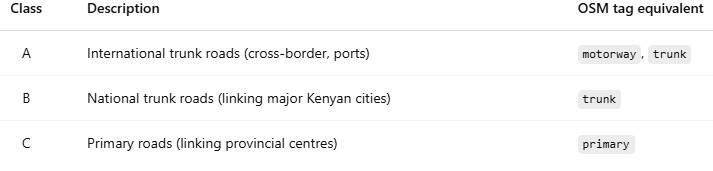

- motorway (Class A) – e.g. Mombasa–Nairobi expressway
- trunk (Class A/B) – national highways under KeNHA
- primary (Class C) – key provincial links
- secondary (County “D” roads) – major feeders to Class C

In [89]:
#loading dataset
transport = gpd.read_file('/content/drive/MyDrive/Capstone Project/hotosm_ken_roads_lines_geojson/hotosm_ken_roads_lines_geojson.geojson')

print(transport.highway.value_counts())

highway
residential       265839
path              129804
unclassified      126935
track              93307
service            40175
tertiary            7024
footway             6830
secondary           3432
trunk               2849
primary             1190
trunk_link           549
living_street        322
steps                263
secondary_link       240
road                 226
pedestrian           202
primary_link         164
tertiary_link        115
cycleway             103
motorway_link         66
construction          63
motorway              58
bridleway             19
raceway               12
yes                    4
crossing               2
corridor               1
minor                  1
proposed               1
services               1
Name: count, dtype: int64


- According to the OSM Wiki, the hierarchy is (most→least important) :
- motorway → trunk → primary → secondary → tertiary → unclassified/service etc

**Which to Keep for Pipeline-Routing Risk**

- We want to know where the pipeline comes near or crosses major corridors that is roads that:

1.  Carry heavy traffic and thus pose third-party damage risk

2. Require special crossing methods (e.g. HDD under a motorway)

3. Are subject to stricter regulatory setbacks


Rationale:

- Tertiary & below are designed for neighborhood access, not through traffic—minimal risk of third-party heavy vehicles .

- Construction/proposed aren’t physically there yet, so they can’t pose risk.

In [90]:
# your transport_df has column 'highway'
major = ['motorway','trunk','primary','secondary',
         'motorway_link','trunk_link','primary_link','secondary_link']

# keep only roads that could affect pipeline
transport_filtered= transport[ transport['highway'].isin(major) ]


- Now transport dataframe holds only those corridors where your pipeline must pay special attention—e.g. deeper bedding, HDD crossings, extra setbacks—while you safely ignore the rest.

### ASSESSING DISTANCE TO TRANSPORT INFRASTRUCTURE

**Policy Context**
1. Pipeline Right-of-Way (ROW) corridor
- Major oil pipelines in Kenya (e.g. EACOP) are built within a 30–100 m-wide ROW to allow construction access, monitoring and spill response .

2. No-disturbance zone under roads
- Kenya’s Highways Regulations require that any excavation for a pipe crossing under a road use micro-tunneling or open cut only with permission—and that no soil disturbance occur within 25 ft (≈7.6 m) of the existing road centerline without authority oversight
INGAA
.

3. Minimum horizontal separation
- ESIA reports for Kenyan pipelines specify that horizontal separation between a pipeline and any other utility (including roads) must be the greater of the owner’s standard or 2.5 m (OD-to-OD) .

4. Road-network classification
- under the Kenya Roads Act and KeNHA mandate, only Class S (motorway), A (international trunk), B (national trunk) and C (primary) roads carry the traffic volumes and regulatory scrutiny that materially affect pipeline siting
Wikipedia
Wikipedia
.

5. OSM highway tags
- In OpenStreetMap these correspond to motorway, trunk, primary, secondary and their “_link” ramps; lower-order roads (tertiary and below) can be dropped for pipeline-safety analysis .

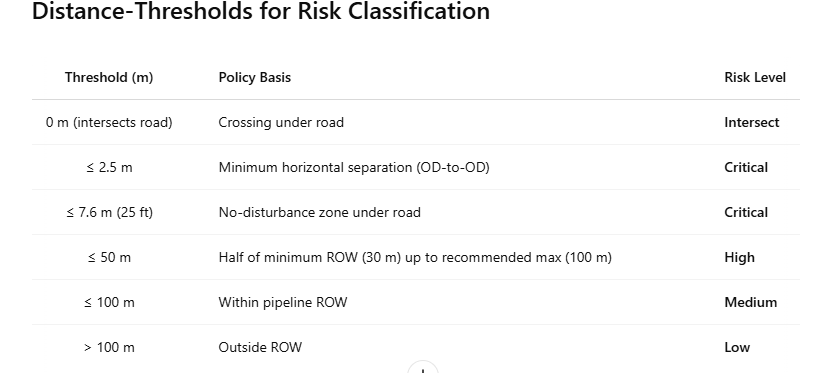

In [91]:
# Function that computes pipeline proximity or distance-to-major-roads and flag risk

def integrate_road_risk(pipeline_gdf, roads_gdf, buffer_half_width=50):
    """
    Add road-proximity risk metrics to pipeline segments.

    Parameters
    ----------
    pipeline_gdf : GeoDataFrame
        Pipeline segments (must have geometry, in EPSG:4326 or projected).
    roads_gdf : GeoDataFrame
        Major roads (filtered to motorway/trunk/primary/secondary and their _link types).
    buffer_half_width : float
        Half the desired ROW width in meters (default 50 m → 100 m total ROW).

    Returns
    -------
    GeoDataFrame
        pipeline_gdf with additional columns:
        - dist_to_road (m)
        - within_no_disturb (bool)
        - within_row (bool)
        - road_risk (Intersect/Critical/High/Medium/Low)
    """
    # 1. reproject both to UTM37S for accurate meter distances
    utm = 32737
    pip = pipeline_gdf.to_crs(epsg=utm).reset_index(drop=True)
    rds = roads_gdf.to_crs(epsg=utm)

    # 2. unique ID for join
    pip['uid'] = pip.index

    # 3. compute distance to nearest road
    nearest = gpd.sjoin_nearest(
        pip[['uid','geometry']],
        rds[['geometry']],
        how='left',
        distance_col='dist_to_road'
    )
    pip = pip.merge(nearest[['uid','dist_to_road']], on='uid', how='left')
    pip['dist_to_road'] = pip['dist_to_road'].fillna(float('inf'))

    # 4. no-disturbance zone (25 ft ≈ 7.6 m)
    no_disturb = 7.6
    pip['within_no_disturb'] = pip['dist_to_road'] <= no_disturb

    # 5. ROW buffer (buffer_half_width either side)
    pip['within_row'] = pip['dist_to_road'] <= buffer_half_width

    # 6. classify risk
    def classify(d):
        if d == 0:
            return 'Intersect'
        if d <= 2.5:
            return 'Critical'
        if d <= no_disturb:
            return 'Critical'
        if d <= buffer_half_width/2:
            return 'High'
        if d <= buffer_half_width:
            return 'Medium'
        return 'Low'

    pip['road_risk'] = pip['dist_to_road'].apply(classify)

    # restore original CRS
    return pip.to_crs(pipeline_gdf.crs)


segments_gdf = integrate_road_risk(segments_gdf, transport_filtered, buffer_half_width=50)

#checking
segments_gdf.head()


,pipeline_id,pipe_location,geometry,segment_distance,angle_segments,sharp_bend,mean_curvature,max_curvature,std_curvature,start_elevation,...,conservancy_intersecting_ids,conservancy_dist,conservancy_within_buf,conservancy_risk,conservancy_compliant,uid,dist_to_road,within_no_disturb,within_row,road_risk
0,141167,Above ground,"LINESTRING (374035.932 10034685.62, 376683.922...",11670.927717,NaN,False,28.372436,44.984188,20.117647,1485,...,[],40993.311908,False,Low,True,0,4598.312563,False,False,Low
1,141167,Above ground,"LINESTRING (376683.922 10046052.181, 378003.99...",1648.939695,-40.069480,False,28.372436,44.984188,20.117647,1290,...,[],42118.411872,False,Low,True,1,7206.888013,False,False,Low
2,141167,Above ground,"LINESTRING (378003.993 10047040.317, 378094.23...",637.647528,44.984188,False,28.372436,44.984188,20.117647,1269,...,[],43312.136688,False,Low,True,2,6604.447160,False,False,Low
3,141167,Above ground,"LINESTRING (378094.23 10047671.547, 378667.979...",4023.061024,0.063638,False,28.372436,44.984188,20.117647,1222,...,[],43340.077882,False,Low,True,3,2837.541765,False,False,Low
4,141200,Underground,"LINESTRING (264853.662 9843375.296, 267224.488...",3239.585203,NaN,False,27.087673,27.087673,NaN,1547,...,[],59674.680919,False,Low,True,4,5332.152947,False,False,Low


### **ADDING COUNTY DATA FOR EACH PIPELINE SEGMENT**

**Why Add County Information?**

- Adding county data to your pipeline segments allows the model to:

1. Consider Regional Constraints: Different counties may have unique regulations or environmental considerations (e.g., Mombasa’s coastal areas vs. Baringo’s arid regions).
2. Enhance Risk Assessment: County-specific data can inform risks, such as population density or infrastructure in Mombasa, impacting pipeline placement.
3. Improve Route Optimization: Knowing counties helps the model balance geographic and administrative factors, ensuring practical routes.

- **Solution :**
1. **Spatial Join:** Use a spatial join to identify which county Polygons each pipeline LineString intersects, handling cases where a segment crosses multiple counties.
2.  **CRS Alignment:** Change the CRS from EPSG:4326 (WGS 84) to UTM Zone 37S (EPSG:32737) :
- ***Why***
- EPSG:4326 is a geographic CRS that uses degrees of latitude and longitude, which makes it **good for mapping and visualizing locations**.
- However,  it's **Bad for geometry-based calculations like distance, area, or accurate intersection analysis** because **degrees aren't uniform — 1° of longitude ≠ same distance everywhere.**
- EPSG:32737 (UTM Zone 37S) is a projected CRS that **uses meters as units** and is designed to **minimize distortion over smaller zones, like Kenya**.

- UTM Zone 37S specifically covers most of southern Kenya, so it's ideal for accurate geometry computations there.





In [92]:
#function that attaches the adminstrative location of each pipeline segment
def add_counties(pipeline_gdf, counties_gdf):
    """
    Add intersecting counties to pipeline segments DataFrame.

    Parameters:
    - pipeline_gdf: GeoDataFrame of pipeline segments with geometry and attributes
    - counties_gdf: GeoDataFrame of Kenyan counties with name and geometry

    Returns:
    - pipeline_gdf with added column: intersecting_counties (list of county names)
    """
    # 1. Reproject both to UTM for accurate spatial operations
    utm_epsg = 32737
    pipeline_utm = pipeline_gdf.to_crs(epsg=utm_epsg).reset_index(drop=True)
    counties_utm = counties_gdf.to_crs(epsg=utm_epsg)

    # 2. Tag each row with a unique ID
    pipeline_utm['uid'] = pipeline_utm.index

    # 3. Spatial join on geometry only (carry uid forward)
    joined = gpd.sjoin(
        pipeline_utm[['uid', 'geometry']],
        counties_utm[['name', 'geometry']],
        how='left',
        predicate='intersects'
    )

    # 4. Group by uid to collect all county names per pipeline segment
    intersect_summary = (
        joined.groupby('uid')
              .agg(intersecting_counties=('name', lambda names: list(set(names.dropna()))))
              .reset_index()
    )

    # 5. Merge back onto pipeline_utm via uid
    pipeline_utm = pipeline_utm.merge(intersect_summary, on='uid', how='left')

    # 6. Fill segments with no matches with empty list
    pipeline_utm['intersecting_counties'] = pipeline_utm['intersecting_counties'].apply(
        lambda x: x if isinstance(x, list) else []
    )

    # 7. Drop the helper uid column (optional)
    pipeline_utm.drop(columns=['uid'], inplace=True)

    # 8. Reproject back to original CRS
    return pipeline_utm.to_crs(pipeline_gdf.crs)


In [93]:
#checking
segments_gdf.head()

,pipeline_id,pipe_location,geometry,segment_distance,angle_segments,sharp_bend,mean_curvature,max_curvature,std_curvature,start_elevation,...,conservancy_intersecting_ids,conservancy_dist,conservancy_within_buf,conservancy_risk,conservancy_compliant,uid,dist_to_road,within_no_disturb,within_row,road_risk
0,141167,Above ground,"LINESTRING (374035.932 10034685.62, 376683.922...",11670.927717,NaN,False,28.372436,44.984188,20.117647,1485,...,[],40993.311908,False,Low,True,0,4598.312563,False,False,Low
1,141167,Above ground,"LINESTRING (376683.922 10046052.181, 378003.99...",1648.939695,-40.069480,False,28.372436,44.984188,20.117647,1290,...,[],42118.411872,False,Low,True,1,7206.888013,False,False,Low
2,141167,Above ground,"LINESTRING (378003.993 10047040.317, 378094.23...",637.647528,44.984188,False,28.372436,44.984188,20.117647,1269,...,[],43312.136688,False,Low,True,2,6604.447160,False,False,Low
3,141167,Above ground,"LINESTRING (378094.23 10047671.547, 378667.979...",4023.061024,0.063638,False,28.372436,44.984188,20.117647,1222,...,[],43340.077882,False,Low,True,3,2837.541765,False,False,Low
4,141200,Underground,"LINESTRING (264853.662 9843375.296, 267224.488...",3239.585203,NaN,False,27.087673,27.087673,NaN,1547,...,[],59674.680919,False,Low,True,4,5332.152947,False,False,Low


### **ADDING DATA ON KENYAN SETTLEMENTS**
- Settlement data **helps identify densely populated urban centers and growth corridors, such as Nairobi and its satellite towns (e.g., Thika, Kitengela)**.
- Our dataset has information on High-consequence area (HCA) mapping which identifies clusters (cities, towns, villages) where extra safety, wayleave, and community engagement are mandatory .
- Pipelines **should avoid routing through these areas to reduce land acquisition costs, minimize disruptions to infrastructure, and lower safety risks associated with urban density.**


**TABULATING RISK**
- **The core issue is to treat pipeline segments near populated areas as HCAs, requiring enhanced safety protocols.**. This approach solves it by systematically identifying such segments, assigning risk tiers based on settlement type, and providing additional proximity data
- We treat any pipeline segment passing near cities, towns, or villages as a High-Consequence Area (HCA) requiring extra safety measures
- We will draw on Kenyan EIA law, PHMSA High-Consequence Area (HCA) practice, and GIS risk-modeling best-practices to define buffers, join to your settlement layer, and assign risk tiers.
1. Kenyan EIA & NEMA Guidelines
- **EIA requirement**: EMCA 1999 & NEMA EIA Regulations mandate identifying “high-sensitivity land uses” (settlements, schools, markets) within 500 m of a project and prescribing setbacks or mitigation
NEMA
- Community consultation: Pipelines through populated areas trigger formal wayleave agreements and local stakeholder engagement under Section 58 EMCA
2. PHMSA High-Consequence Areas (HCA)
- **HCA definition**: US PHMSA defines an HCA as any pipeline segment with ≥20 buildings within a 660 ft (200 m) radius or where people gather
PHMSA
- **Consequence factor**: Population density within the buffer multiplies risk scores by 2–5× under PHMSA’s RRIM model



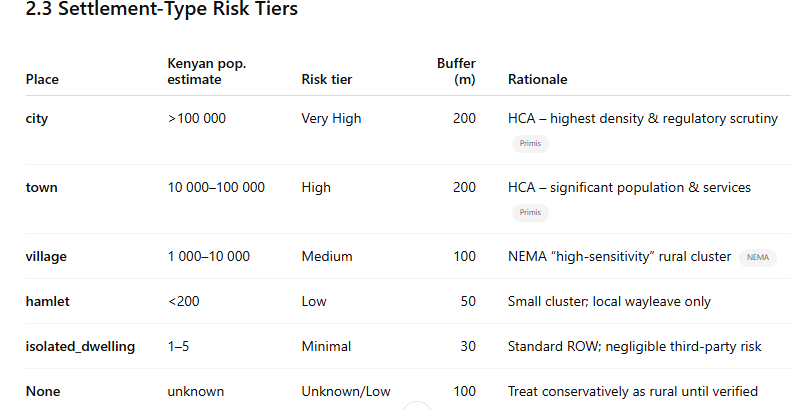

**STEPS:**
1. Filter settlements   with cross-reference population density data (e.g., from HDX Kenya Population Density) to refine risk tiers. For example:
- 'City' with >10,000 people/km²: 'Very High'.
- 'Town' with 1,000–10,000 people/km²: 'High'.
- 'Village' with 100–1,000 people/km²: 'Medium'.
- 'Hamlet' with <100 people/km²: 'Low'.
- **Reason**: Population density directly correlates with the severity of a pipeline incident. Kenyan EIA guidelines emphasize protecting densely populated areas, and this approach better aligns with international standards like ASME B31.8S.

2. Define buffer distances based on pipeline characteristics (e.g., contents, diameter, pressure) and Kenyan regulations
- **Reason**: Different pipelines pose varying risks (e.g., gas pipelines have larger blast radii). Kenyan EIAs often require project-specific buffers, and dynamic distances ensure compliance and safety.
- Gas pipelines: 300m for 'Very High', 200m for 'High', 150m for 'Medium', 100m for 'Low'.
- Oil pipelines: 200m, 150m, 100m, 50m (less volatile than gas).
- Adjust based on NEMA guidelines (e.g., 100–500m for urban areas).

In [94]:
urban_settlements=gpd.read_file('/content/drive/MyDrive/Capstone Project/hotosm_ken_populated_places_points_shp')
urban_settlements.isna().sum()
#drop null values in place column
urban_settlements=urban_settlements.dropna(subset=['place'])

In [95]:
#checking
urban_settlements.isna().sum()

,0
name,642
name_en,9489
place,0
landuse,9497
population,9431
is_in,9229
source,8542
name_sw,9495
osm_id,0
osm_type,0


In [96]:
#function that assess proximity of pipeline to settlements and flags

def validate_geodataframe(gdf, name, required_columns=None):
    """Validate GeoDataFrame for required properties."""
    if not isinstance(gdf, gpd.GeoDataFrame):
        raise ValueError(f"{name} must be a GeoDataFrame")
    if not gdf.crs:
        raise ValueError(f"{name} must have a defined CRS")
    if 'geometry' not in gdf.columns:
        raise ValueError(f"{name} must contain a 'geometry' column")
    if required_columns:
        missing = [col for col in required_columns if col not in gdf.columns]
        if missing:
            raise ValueError(f"{name} missing required columns: {missing}")
    if not gdf.geometry.is_valid.all():
        print(f"Warning: Fixing invalid geometries in {name}...")
        gdf.geometry = gdf.geometry.buffer(0)
    return gdf

def flag_population_risk(pipe, pop_pts, pipeline_type='oil', min_safe_distance=100, crs_epsg=32737, batch_size=500):
    """
    Flag pipeline segments as High-Consequence Areas (HCAs) based on proximity to settlements,
    using settlement type, multi-scale clustering, and pipeline-specific modifiers as population proxies.

    Parameters:
    - pipe: GeoDataFrame of pipeline segments (with 'pipeline_id', 'pipe_location')
    - pop_pts: GeoDataFrame of HOTOSM settlement points (with 'place')
    - pipeline_type: Type of pipeline ('oil' or 'gas', default 'oil')
    - min_safe_distance: Minimum safe distance per Kenyan EIA standards (default 100m)
    - crs_epsg: EPSG code for metric CRS (default 32737, UTM Zone 37S)
    - batch_size: Number of settlements to process per batch (default 500)

    Modifies:
    - pipe GeoDataFrame in place by adding columns:
      population_risk, dist_to_pop, risk_score, compliant, nearest_settlement_type, settlement_count
    """
    # Step 1: Validate inputs
    pipe = validate_geodataframe(pipe, "Pipelines", required_columns=['pipeline_id', 'pipe_location'])
    pop_pts = validate_geodataframe(pop_pts, "Settlements", required_columns=['place'])

    print(f"Processing {len(pipe)} pipeline segments and {len(pop_pts)} settlements...")

    # Step 2: Filter settlements and assign base risk weights
    keep = {'city', 'town', 'village', 'hamlet', 'isolated_dwelling'}
    pop = pop_pts[pop_pts['place'].isin(keep)].copy()
    if pop.empty:
        raise ValueError("No valid settlements found in pop_pts")
    risk_weights = {'city': 5, 'town': 3.5, 'village': 2, 'hamlet': 1, 'isolated_dwelling': 0.5}
    pop['risk_weight'] = pop['place'].map(risk_weights).fillna(1).astype(np.float32)

    # Step 3: Reproject to metric CRS
    original_crs = pipe.crs
    pipe_utm = pipe.to_crs(epsg=crs_epsg).reset_index(drop=True).assign(uid=range(len(pipe)))
    pop_utm = pop.to_crs(epsg=crs_epsg).reset_index(drop=True)

    # Step 4: Multi-scale spatial clustering
    print("Clustering settlements to estimate population density...")
    coords = np.array([[p.x, p.y] for p in pop_utm.geometry])
    with tqdm(total=2, desc="DBSCAN Clustering") as pbar:
        # Local clustering (500m)
        db_local = DBSCAN(eps=500, min_samples=3, metric='euclidean').fit(coords)
        pop_utm['cluster_local'] = db_local.labels_
        cluster_sizes_local = pop_utm[pop_utm['cluster_local'] != -1].groupby('cluster_local').size()
        pop_utm['cluster_size_local'] = pop_utm['cluster_local'].map(cluster_sizes_local).fillna(1).astype(np.float32)
        pbar.update(1)

        # Regional clustering (2000m)
        db_regional = DBSCAN(eps=2000, min_samples=5, metric='euclidean').fit(coords)
        pop_utm['cluster_regional'] = db_regional.labels_
        cluster_sizes_regional = pop_utm[pop_utm['cluster_regional'] != -1].groupby('cluster_regional').size()
        pop_utm['cluster_size_regional'] = pop_utm['cluster_regional'].map(cluster_sizes_regional).fillna(1).astype(np.float32)
        pbar.update(1)

    # Normalize cluster sizes to prevent overfitting
    max_local = pop_utm['cluster_size_local'].max()
    max_regional = pop_utm['cluster_size_regional'].max()
    pop_utm['cluster_score'] = (
        pop_utm['risk_weight'] * (
            0.7 * np.log1p(pop_utm['cluster_size_local']) / np.log1p(max_local) +
            0.3 * np.log1p(pop_utm['cluster_size_regional']) / np.log1p(max_regional)
        )
    ).astype(np.float32)

    # Step 5: Define dynamic buffer distances
    buffer_defs = {
        'gas': {'city': 300, 'town': 200, 'village': 150, 'hamlet': 100, 'isolated_dwelling': 50},
        'oil': {'city': 200, 'town': 150, 'village': 100, 'hamlet': 50, 'isolated_dwelling': 25}
    }
    pop_utm['buffer'] = pop_utm['place'].map(buffer_defs[pipeline_type]).astype(np.float32)

    # Step 6: Batch process spatial joins
    print("Performing spatial joins in batches...")
    pipe_utm['risk_score'] = 0.0
    pipe_utm['settlement_count'] = 0
    batches = [pop_utm[i:i + batch_size] for i in range(0, len(pop_utm), batch_size)]
    for batch in tqdm(batches, desc="Spatial Joins"):
        batch_buffer = batch.copy().reset_index(drop=True)
        batch_buffer['geometry'] = batch_buffer.geometry.buffer(batch_buffer['buffer'])
        joined = gpd.sjoin(
            pipe_utm[['uid', 'geometry']],
            batch_buffer[['cluster_score', 'geometry']],
            how='left', predicate='intersects'
        ).reset_index(drop=True)

        # Corrected aggregation
        summary = joined.groupby('uid').agg(
            batch_score=('cluster_score', 'max'),
            batch_count=('cluster_score', 'count')
        ).reset_index()

        for idx, row in summary.iterrows():
            if pd.notna(row['batch_score']):
                pipe_utm.loc[pipe_utm['uid'] == row['uid'], 'risk_score'] = max(
                    pipe_utm.loc[pipe_utm['uid'] == row['uid'], 'risk_score'].iloc[0], row['batch_score']
                )
                pipe_utm.loc[pipe_utm['uid'] == row['uid'], 'settlement_count'] += row['batch_count']
        del batch_buffer, joined, summary
        gc.collect()

    # Step 7: Compute distance to nearest settlement
    print("Computing distances to nearest settlements...")
    with tqdm(total=1, desc="Nearest Settlement") as pbar:
        nearest = gpd.sjoin_nearest(
            pipe_utm[['uid', 'geometry']],
            pop_utm[['place', 'geometry']],
            how='left', distance_col='dist_to_pop'
        ).reset_index(drop=True)
        pipe_utm = pipe_utm.merge(nearest[['uid', 'dist_to_pop', 'place']], on='uid', how='left')
        pipe_utm['dist_to_pop'] = pipe_utm['dist_to_pop'].fillna(float('inf')).astype(np.float32)
        pipe_utm['nearest_settlement_type'] = pipe_utm['place'].fillna('None').astype('category')
        pbar.update(1)

    # Step 8: Apply pipeline-specific modifiers
    hazard_multiplier = 1.5 if pipeline_type == 'gas' else 1.0
    location_modifier = pipe_utm['pipe_location'].map({'Above ground': 1.5, 'Underground': 1.0}).fillna(1.0).astype(np.float32)
    pipe_utm['risk_score'] = (pipe_utm['risk_score'] * hazard_multiplier * location_modifier).astype(np.float32)

    # Step 9: Classify risk tiers
    bins = [-1, 0, 0.5, 2, 5, float('inf')]
    labels = ['Minimal', 'Low', 'Medium', 'High', 'Very High']
    pipe_utm['population_risk'] = pd.cut(pipe_utm['risk_score'], bins=bins, labels=labels, include_lowest=True).astype('category')

    # Step 10: Check compliance
    pipe_utm['compliant'] = (pipe_utm['dist_to_pop'] >= min_safe_distance).astype(bool)

    return pipe_utm

In [97]:
segments_gdf=flag_population_risk( segments_gdf , urban_settlements, pipeline_type='oil', min_safe_distance=100, crs_epsg=32737, batch_size=500)

Processing 276 pipeline segments and 9498 settlements...
Clustering settlements to estimate population density...


DBSCAN Clustering: 100%|██████████| 2/2 [00:00<00:00, 18.90it/s]


Performing spatial joins in batches...


Spatial Joins: 100%|██████████| 19/19 [00:04<00:00,  4.15it/s]


Computing distances to nearest settlements...


Nearest Settlement: 100%|██████████| 1/1 [00:00<00:00, 51.56it/s]


The code identifies High-Consequence Areas (HCAs) for pipeline segments based on proximity to settlements. It:

Validates GeoDataFrames to ensure data integrity.

Clusters settlements to estimate population density.

Calculates risk scores for pipeline segments based on clustering results, settlement proximity, and pipeline-specific modifiers.

Classifies risk tiers and checks compliance with safety standards.

In [98]:
#checking
segments_gdf.head()

,pipeline_id,pipe_location,geometry,segment_distance,angle_segments,sharp_bend,mean_curvature,max_curvature,std_curvature,start_elevation,...,within_no_disturb,within_row,road_risk,risk_score,settlement_count,dist_to_pop,place,nearest_settlement_type,population_risk,compliant
0,141167,Above ground,"LINESTRING (374035.932 10034685.62, 376683.922...",11670.927717,NaN,False,28.372436,44.984188,20.117647,1485,...,False,False,Low,0.0,0,6997.475586,town,town,Minimal,True
1,141167,Above ground,"LINESTRING (376683.922 10046052.181, 378003.99...",1648.939695,-40.069480,False,28.372436,44.984188,20.117647,1290,...,False,False,Low,0.0,0,7399.514160,hamlet,hamlet,Minimal,True
2,141167,Above ground,"LINESTRING (378003.993 10047040.317, 378094.23...",637.647528,44.984188,False,28.372436,44.984188,20.117647,1269,...,False,False,Low,0.0,0,6765.038086,hamlet,hamlet,Minimal,True
3,141167,Above ground,"LINESTRING (378094.23 10047671.547, 378667.979...",4023.061024,0.063638,False,28.372436,44.984188,20.117647,1222,...,False,False,Low,0.0,0,2796.602051,hamlet,hamlet,Minimal,True
4,141200,Underground,"LINESTRING (264853.662 9843375.296, 267224.488...",3239.585203,NaN,False,27.087673,27.087673,NaN,1547,...,False,False,Low,0.0,0,7111.421875,town,town,Minimal,True


In [99]:
#saving work on google drive

# Save GeoDataFrame to GeoPackage
try:
    # Specify the full file path with filename and .gpkg extension
    output_path = "/content/drive/MyDrive/Capstone Project/segments_gdf.gpkg"

    # Save to GeoPackage
    segments_gdf.to_file(output_path, driver="GPKG")
    print(f"GeoDataFrame saved successfully to {output_path}")

    # Step 3: Verify the saved file
    saved_gdf = gpd.read_file(output_path)
    print("Saved GeoDataFrame info:")
    print(saved_gdf.info())
    print(f"CRS preserved: {saved_gdf.crs}")
    print("Sample geometry:")
    print(saved_gdf.geometry.head(1))
except Exception as e:
    print(f"Error saving GeoDataFrame: {e}")

GeoDataFrame saved successfully to /content/drive/MyDrive/Capstone Project/segments_gdf.gpkg
Saved GeoDataFrame info:
<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 297 entries, 0 to 296
Data columns (total 55 columns):
 #   Column                        Non-Null Count  Dtype   
---  ------                        --------------  -----   
 0   pipeline_id                   297 non-null    int64   
 1   pipe_location                 297 non-null    object  
 2   segment_distance              297 non-null    float64 
 3   angle_segments                256 non-null    float64 
 4   sharp_bend                    297 non-null    bool    
 5   mean_curvature                281 non-null    float64 
 6   max_curvature                 281 non-null    float64 
 7   std_curvature                 275 non-null    float64 
 8   start_elevation               297 non-null    int16   
 9   end_elevation                 297 non-null    int16   
 10  gradient                      297 non-null  

# **EXPLOLATORY DATA ANALYSIS**

###1. **DATASET OVERVIEW**

In [129]:
segments_gdf.head()

,pipeline_id,pipe_location,segment_distance,angle_segments,sharp_bend,mean_curvature,max_curvature,std_curvature,start_elevation,end_elevation,...,settlement_count,dist_to_pop,place,nearest_settlement_type,population_risk,compliant,geometry,base_cost_per_m,segment_cost,high_risk
0,141167,Above ground,11670.927717,NaN,False,28.372436,44.984188,20.117647,1485,1290,...,0,6997.475586,town,town,Minimal,True,"LINESTRING (374035.932 10034685.62, 376683.922...",1000,1.167093e+07,0
1,141167,Above ground,1648.939695,-40.069480,False,28.372436,44.984188,20.117647,1290,1269,...,0,7399.514160,hamlet,hamlet,Minimal,True,"LINESTRING (376683.922 10046052.181, 378003.99...",1000,1.648940e+06,0
2,141167,Above ground,637.647528,44.984188,False,28.372436,44.984188,20.117647,1269,1222,...,0,6765.038086,hamlet,hamlet,Minimal,True,"LINESTRING (378003.993 10047040.317, 378094.23...",1000,6.376475e+05,0
3,141167,Above ground,4023.061024,0.063638,False,28.372436,44.984188,20.117647,1222,1118,...,0,2796.602051,hamlet,hamlet,Minimal,True,"LINESTRING (378094.23 10047671.547, 378667.979...",1000,4.023061e+06,0
4,141200,Underground,3239.585203,NaN,False,27.087673,27.087673,NaN,1547,1561,...,0,7111.421875,town,town,Minimal,True,"LINESTRING (264853.662 9843375.296, 267224.488...",2000,6.479170e+06,1


In [130]:
segments_gdf.tail()

,pipeline_id,pipe_location,segment_distance,angle_segments,sharp_bend,mean_curvature,max_curvature,std_curvature,start_elevation,end_elevation,...,settlement_count,dist_to_pop,place,nearest_settlement_type,population_risk,compliant,geometry,base_cost_per_m,segment_cost,high_risk
292,141274,Underground,3988.322306,NaN,False,NaN,NaN,NaN,443,436,...,0,5854.046387,village,village,Minimal,True,"LINESTRING (484964.17 9593535.596, 488286.977 ...",2000,7.976645e+06,0
293,141275,Underground,12604.606929,NaN,False,NaN,NaN,NaN,206,193,...,0,531.580200,town,town,Minimal,True,"LINESTRING (541153.009 9571904.915, 553754.58 ...",2000,2.520921e+07,0
294,141275,Underground,12604.606929,NaN,False,NaN,NaN,NaN,206,193,...,0,531.580200,town,town,Minimal,True,"LINESTRING (541153.009 9571904.915, 553754.58 ...",2000,2.520921e+07,0
295,141276,Underground,3147.713632,NaN,False,NaN,NaN,NaN,203,94,...,0,306.478607,village,village,Minimal,True,"LINESTRING (563171.572 9565064.621, 565027.149...",2000,6.295427e+06,0
296,141277,Above ground,2133.942245,NaN,False,NaN,NaN,NaN,186,176,...,0,2225.691895,town,town,Minimal,True,"LINESTRING (550992.788 9571148.438, 549132.553...",1000,2.133942e+06,0


In [131]:
#shape of dataset
shape=segments_gdf.shape
print(f'The dataset has {shape[1]} columns and {shape[0] } rows')

The dataset has 58 columns and 297 rows


In [127]:
# Data Overview and Summary Statistics
print(" Data Overview and Summary Statistics")
print("\nDataset Info:")
segments_gdf.info()


 Data Overview and Summary Statistics

Dataset Info:
<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 297 entries, 0 to 296
Data columns (total 58 columns):
 #   Column                        Non-Null Count  Dtype   
---  ------                        --------------  -----   
 0   pipeline_id                   297 non-null    int64   
 1   pipe_location                 297 non-null    object  
 2   segment_distance              297 non-null    float64 
 3   angle_segments                256 non-null    float64 
 4   sharp_bend                    297 non-null    bool    
 5   mean_curvature                281 non-null    float64 
 6   max_curvature                 281 non-null    float64 
 7   std_curvature                 275 non-null    float64 
 8   start_elevation               297 non-null    int16   
 9   end_elevation                 297 non-null    int16   
 10  gradient                      297 non-null    float64 
 11  gradient_percentage           297 non-null    flo

In [133]:
#concise summary statistics
print("\nSummary Statistics (Numerical):")
segments_gdf.describe()



Summary Statistics (Numerical):


,pipeline_id,segment_distance,angle_segments,mean_curvature,max_curvature,std_curvature,start_elevation,end_elevation,gradient,gradient_percentage,...,conservancy_intersect_count,conservancy_dist,uid,dist_to_road,risk_score,settlement_count,dist_to_pop,base_cost_per_m,segment_cost,high_risk
count,297.000000,297.000000,256.000000,281.000000,281.000000,275.000000,297.000000,297.000000,297.000000,297.000000,...,297.0,297.000000,297.000000,297.000000,297.000000,297.000000,297.000000,297.000000,2.970000e+02,297.000000
mean,141222.952862,3798.854157,-2.108708,24.535579,79.664540,21.132755,891.922559,897.983165,0.004338,0.433779,...,1.0,100510.437808,131.245791,5987.479523,0.005180,0.016835,5040.352539,1350.168350,5.527363e+06,0.323232
std,24.929993,3661.770306,37.417605,16.194680,61.162044,13.172802,490.310227,494.388733,0.025034,2.503441,...,0.0,39089.206630,81.209170,7218.890965,0.040480,0.128870,4737.398926,477.827614,6.618315e+06,0.468500
min,141167.000000,61.233173,-143.405734,0.020854,0.020854,3.228306,26.000000,26.000000,-0.095797,-9.579690,...,1.0,26162.690148,0.000000,0.000000,0.000000,0.000000,7.632150,1000.000000,1.224663e+05,0.000000
25%,141202.000000,1262.175426,-17.975177,9.037141,25.811931,8.744312,535.000000,525.000000,-0.004686,-0.468616,...,1.0,72731.787772,54.000000,588.293951,0.000000,0.000000,1563.787964,1000.000000,1.597557e+06,0.000000
50%,141215.000000,2559.884217,-0.011929,17.578675,48.200333,14.200690,765.000000,769.000000,0.002127,0.212729,...,1.0,102992.402358,128.000000,2932.869588,0.000000,0.000000,3583.529297,1000.000000,3.033176e+06,0.000000
75%,141239.000000,4661.475987,9.107330,43.834428,161.561986,37.419034,1286.000000,1269.000000,0.009740,0.974046,...,1.0,117842.352497,202.000000,8505.604546,0.000000,0.000000,6839.334473,2000.000000,6.479170e+06,1.000000
max,141277.000000,23885.597697,161.561986,46.076512,161.561986,37.419034,1925.000000,2198.000000,0.107779,10.777943,...,1.0,176805.356616,275.000000,25520.269049,0.384579,1.000000,26290.156250,2000.000000,4.777120e+07,1.000000


In [140]:
# concise summary of categorical columns
new=segments_gdf.copy()
categorical_columns = new.select_dtypes(include=['object']).columns
new[categorical_columns] = new[categorical_columns].astype('category')
print("\nSummary Statistics (categorical):")
new.describe(include=['category'])


Summary Statistics (categorical):


,pipe_location,intersecting_waterways,waterway_risk,lake_intersecting_ids,lake_risk,forest_intersecting_ids,forest_risk,park_intersecting_ids,park_risk,conservancy_intersecting_ids,conservancy_risk,road_risk,place,nearest_settlement_type,population_risk
count,297,297,297,297,297,297,297,297,297,297,297,297,297,297,297
unique,2,2,3,2,2,3,2,4,4,1,1,3,4,4,2
top,Above ground,[],Low,[],Low,[],Low,[],Low,[],Low,Low,village,village,Minimal
freq,193,268,265,293,293,256,256,268,235,297,297,263,230,230,292


In [137]:
#checking the datatypes:
segments_gdf.dtypes

,0
pipeline_id,int64
pipe_location,object
segment_distance,float64
angle_segments,float64
sharp_bend,bool
mean_curvature,float64
max_curvature,float64
std_curvature,float64
start_elevation,int16
end_elevation,int16


In [161]:
#checking null values
segments_gdf.isna().sum()

,0
pipeline_id,0
pipe_location,0
segment_distance,0
angle_segments,41
sharp_bend,0
mean_curvature,16
max_curvature,16
std_curvature,22
start_elevation,0
end_elevation,0


In [163]:
# Calculate the percentage of null values for each column
null_percentage = (segments_gdf.isna().sum() / len(segments_gdf)) * 100

# Filter to show only columns with null values
null_percentage = null_percentage[null_percentage > 0]

# Print columns with their percentage of null values
print("Columns with Null Values and Their Percentage:")
print(null_percentage)

Columns with Null Values and Their Percentage:
angle_segments    13.804714
mean_curvature     5.387205
max_curvature      5.387205
std_curvature      7.407407
dtype: float64


# DATA CLEANING

- Dealing with null values based on group-specific medians (that is grouped by pipe_location such as "Above ground" or "Underground"):

In [164]:
# Fill null values with group-specific medians based on `pipe_location`
group_columns = ['angle_segments', 'mean_curvature', 'max_curvature', 'std_curvature']

# Apply group-specific median filling for each column
for column in group_columns:
    segments_gdf[column] = segments_gdf.groupby('pipe_location')[column].transform(
        lambda x: x.fillna(x.median())
    )

# Verify that null values are handled
print("Null values after group-specific median filling:")
print(segments_gdf.isna().sum())

Null values after group-specific median filling:
pipeline_id                     0
pipe_location                   0
segment_distance                0
angle_segments                  0
sharp_bend                      0
mean_curvature                  0
max_curvature                   0
std_curvature                   0
start_elevation                 0
end_elevation                   0
gradient                        0
gradient_percentage             0
gradient_degrees                0
steepness                       0
intersecting_waterways          0
dist_to_waterway                0
within_buffer                   0
waterway_risk                   0
lake_intersect_count            0
lake_intersecting_ids           0
lake_dist                       0
lake_within_buf                 0
lake_risk                       0
lake_compliant                  0
forest_intersect_count          0
forest_intersecting_ids         0
forest_dist                     0
forest_within_buf               0

## UNIVERIATE ANALYSIS

- ### 1. Plotting various maps from our datasets

<Axes: >

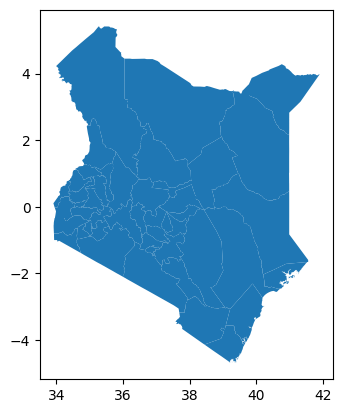

In [100]:
#plotting

kenya_counties.geometry.plot()

In [101]:
counties=len(kenya_counties)
print(f'dataset had {counties} counties')

dataset had 47 counties


NATURE OF PIPELINE SEGMENTS

In [166]:
print('Nature of Pipeline')
print(segments_gdf['pipe_location'].value_counts())

Nature of Pipeline
pipe_location
Above ground    193
Underground     104
Name: count, dtype: int64


Percentage Report:
Above ground: 64.98%
Underground: 35.02%


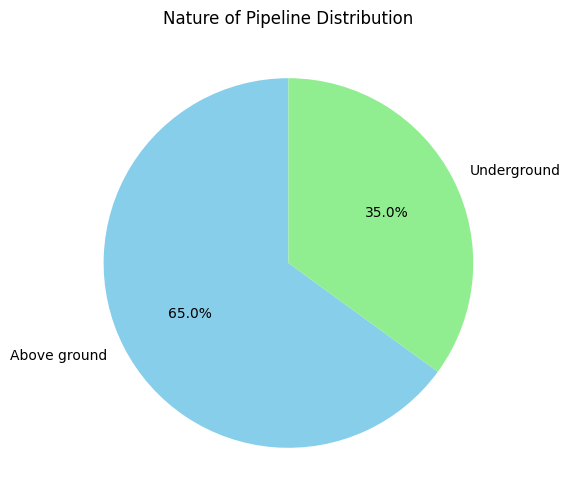

In [167]:
# Data: Nature of Pipeline
data = {
    "Above ground": 193,
    "Underground": 104
}

# Calculate total pipelines
total_pipelines = sum(data.values())

# Calculate percentages
percentages = {key: (value / total_pipelines) * 100 for key, value in data.items()}

# Print percentage report
print("Percentage Report:")
for location, percentage in percentages.items():
    print(f"{location}: {percentage:.2f}%")

# Create a pie chart
plt.figure(figsize=(8, 6))
plt.pie(
    data.values(),
    labels=data.keys(),
    autopct="%1.1f%%",
    startangle=90,
    colors=["skyblue", "lightgreen"]
)
plt.title("Nature of Pipeline Distribution")
plt.show()

Majority of the Pipeline lies (65%) **Above Ground** while 35% is **Below Ground**

###PIPELINE CURVATURE

- **Curvature metrics (angle_segments, mean_curvature, max_curvature, std_curvature, sharp_bend) are critical for oil and gas pipeline construction, as they indicate bending stress, pipe fatigue, and construction costs**

Metrics and Their Importance
1. angle_segments:

* Represents the angular changes between consecutive pipeline segments.
Importance: Large angles may indicate sharp turns or bends, which can increase stress and fatigue on the pipeline.
2. mean_curvature:

* The average curvature of a pipeline segment.
* Importance: Higher mean curvature values suggest consistently curved sections, which may require specialized construction techniques and materials.
max_curvature:

3. The maximum curvature observed within a pipeline segment.
* Importance: Peaks in curvature are critical because they can indicate locations of high stress and potential failure.
std_curvature:

4. The standard deviation of curvature within a pipeline segment.
* Importance: A high standard deviation suggests inconsistent bending along the segment, leading to uneven stress distribution and potential weak spots.

In [168]:
curvature_cols = segments_gdf[['angle_segments', 'mean_curvature', 'max_curvature', 'std_curvature', 'sharp_bend']]
curvature_cols.describe()


,angle_segments,mean_curvature,max_curvature,std_curvature
count,297.000000,297.000000,297.000000,297.000000
mean,-1.818710,24.285781,77.896592,21.149652
std,34.737220,16.010534,60.705208,13.022031
min,-143.405734,0.020854,0.020854,3.228306
25%,-15.254788,9.037141,27.087673,8.744312
50%,-0.004363,15.630689,48.200333,14.200690
75%,7.468672,43.834428,161.561986,37.419034
max,161.561986,46.076512,161.561986,37.419034


**General Insights**
- Pipeline Design Challenges:

* Sharp Bends: The extreme values in angle_segments and max_curvature indicate potential weak points that may require additional reinforcement.
Inconsistent Curvature: High std_curvature values suggest segments with uneven bending, which could lead to fatigue over time.
Construction Costs:

* Sections with high mean_curvature and max_curvature will likely increase construction costs due to the need for specialized materials and techniques.
Structural Risks:

* Curvature peaks (e.g., max_curvature) and sharp angle changes (angle_segments) are critical for determining areas that may experience high stress or fatigue.



VISUALIZATIONS

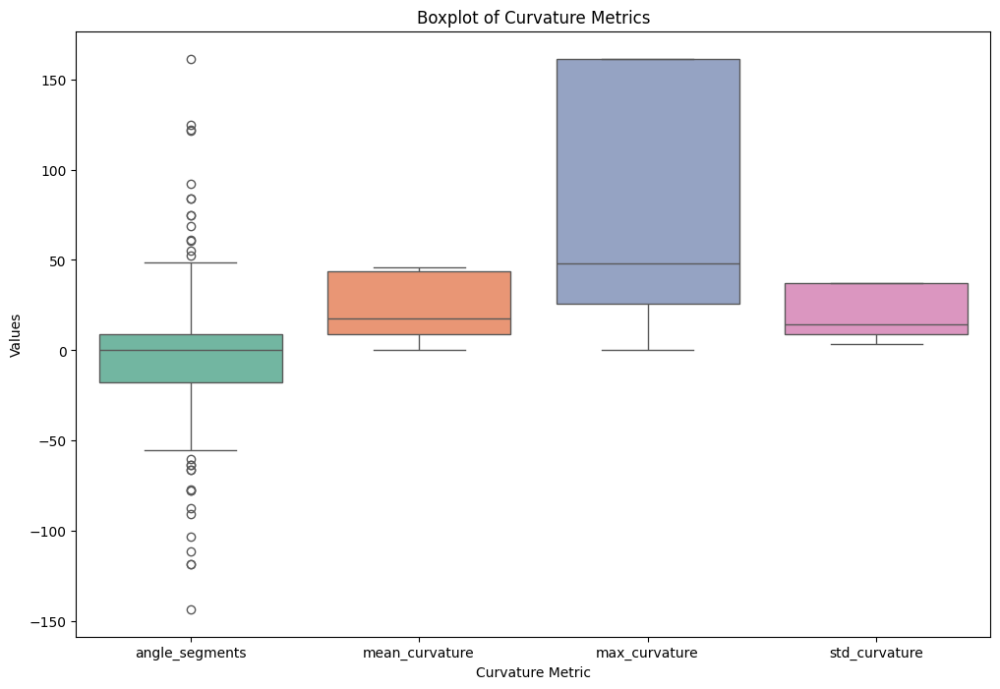

In [195]:
# --- 2. Boxplots: Highlight Outliers and Compare Distributions ---
plt.figure(figsize=(12, 8))
sns.boxplot(data=segments_gdf[columns], palette="Set2")
plt.title('Boxplot of Curvature Metrics')
plt.xlabel('Curvature Metric')
plt.ylabel('Values')
plt.show()



1. angle_segments
- The distribution is centered around 0, with the median close to 0.
A significant number of outliers exist, especially on the lower end (negative values) and some on the higher end (positive values).
This indicates sharp changes in angles for certain pipeline segments, which may represent abrupt bends or turns.
2. mean_curvature
- The spread of the distribution is moderate, with most values concentrated between ~9 and ~44 (interquartile range).
The median lies slightly below the middle of the box, suggesting a slight skew towards lower curvature values.
Few outliers are present, indicating that most segments have consistent mean curvature.
3. max_curvature
- This metric has the largest spread among all metrics, with values ranging from very small to very large.
The box is very tall, indicating high variability in maximum curvature across pipeline segments.
The whiskers are long, and there are no visible outliers, suggesting that high maximum curvatures are relatively common and not considered extreme for this dataset.
4. std_curvature
- The spread of this metric is smaller compared to max_curvature and angle_segments.
Most values lie between ~8 and ~37 (interquartile range), and the median lies near the center of the box.
There are no visible outliers, indicating consistent variability in curvature within segments.

Insights from the Boxplot
1. High Variability in max_curvature:

- The wide spread of the max_curvature values indicates that some segments experience extreme bending stress, which could be critical for structural integrity.
2. Outliers in angle_segments:

- The many outliers in angle_segments suggest sharp turns in certain pipeline segments, which may require additional reinforcement or realignment to reduce stress.
3. Consistency in std_curvature and mean_curvature:

- Both mean_curvature and std_curvature show relatively consistent distributions with minimal outliers, indicating that most pipeline segments have stable average curvature and variability.
4. Pipeline Design Focus:

- Segments with extreme angle_segments and high max_curvature require attention during pipeline construction to mitigate potential stress and fatigue.

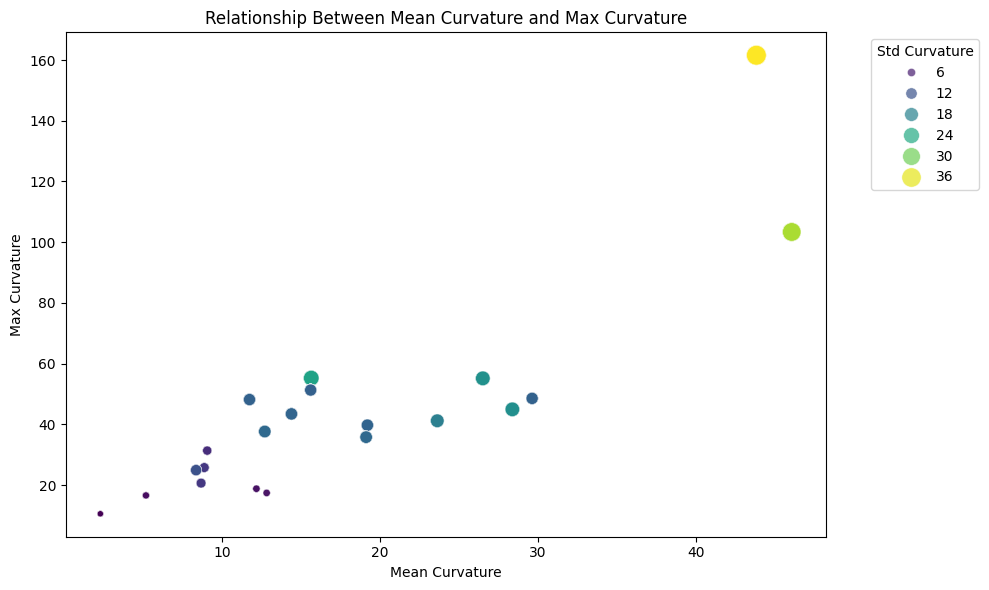

In [196]:
# --- 3. Scatter Plot: Relationship Between Mean Curvature and Max Curvature ---
plt.figure(figsize=(10, 6))
sns.scatterplot(
    data=segments_gdf,
    x='mean_curvature',
    y='max_curvature',
    hue='std_curvature',
    palette='viridis',
    size='std_curvature',
    sizes=(20, 200),
    alpha=0.7
)
plt.title('Relationship Between Mean Curvature and Max Curvature')
plt.xlabel('Mean Curvature')
plt.ylabel('Max Curvature')
plt.legend(title='Std Curvature', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()

* Copilot said: This scatter plot visualizes the **relationship between
This scatter plot visualizes the relationship between Mean Curvature and Max Curvature, with additional dimensions encoded using color and size to represent Std Curvature (Standard Deviation of Curvature).
* Color (Hue):

- Represents the value of Std Curvature (Standard Deviation of Curvature).
Darker colors (purple) indicate lower variability in curvature.
Lighter colors (yellow) indicate higher variability in curvature.

- Size of Points:

- The size of each point is proportional to the value of Std Curvature.
Larger points represent segments with higher variability in curvature.

- plot highlights the relationship between Mean Curvature and Max Curvature while showing how Std Curvature impacts the variability of bending.
- The outliers (large yellow points) represent areas of concern due to high curvature and variability, while the clustered points indicate more uniform and manageable pipeline segments.

1. Positive Correlation:

- There is a general positive correlation between Mean Curvature and Max Curvature.
- Segments with higher mean curvature tend to have higher maximum curvature, indicating more consistent bending.

2. Outliers:

- The point in the upper-right corner (yellow, large) represents a segment with:
- A very high Mean Curvature (~45).
- A very high Max Curvature (~160).
- A high Std Curvature (large size and yellow color), indicating highly inconsistent bending.

- **Variability in Bends- Segments with higher Std Curvature (larger points) may experience uneven stress distribution, increasing the risk of fatigue or failure.**

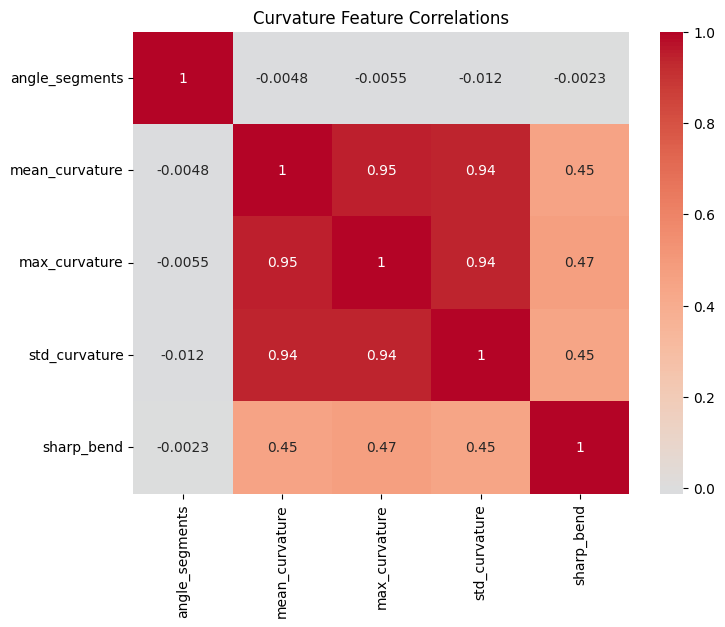

In [169]:
# Correlation heatmap
# Curvature-related columns
curvature_cols = ['angle_segments', 'mean_curvature', 'max_curvature', 'std_curvature', 'sharp_bend']
curvature_data = segments_gdf[curvature_cols].corr()
plt.figure(figsize=(8, 6))
sns.heatmap(curvature_data, annot=True, cmap='coolwarm', center=0)
plt.title("Curvature Feature Correlations")
plt.show()




**Insights from the Heatmap**
1. Strong Relationships:

- mean_curvature, max_curvature, and std_curvature are highly correlated with each other. This suggests that these metrics are interdependent and can collectively capture bending characteristics.
- Pipeline segments with high mean curvature tend to have higher peaks and more variability in curvature, making them key factors for structural analysis.
2. Independence of angle_segments:

- The weak correlations of angle_segments with other features indicate that angular changes in direction are not directly related to curvature metrics in this dataset.
3. Moderate Impact of sharp_bend:

- While sharp_bend is moderately correlated with other curvature metrics, it is distinct in that it captures a specific condition (sharp bends) rather than general curvature characteristics.
4. Pipeline Design Focus:

- The strong correlations between mean_curvature, max_curvature, and std_curvature suggest that these metrics should be analyzed together when assessing bending stress and construction costs.
- Segments with high values in these metrics may require additional reinforcement or adjustments to reduce stress and fatigue.

##**BIVARIATE ANALYSIS**

**Pipeline Coverage Per County:**

- Calculate the Pipeline Distance in Each County
* Use the length attribute of the geometry column to calculate the pipeline length within each county. Ensure the CRS is in meters or another distance-preserving projection.

In [170]:
#Pipeline Coverage Per County:
# Ensure CRS alignment
segments_gdf = segments_gdf.to_crs(kenya_counties.crs)
# Find intersections between pipeline and counties
intersections = gpd.overlay(segments_gdf, kenya_counties, how='intersection')


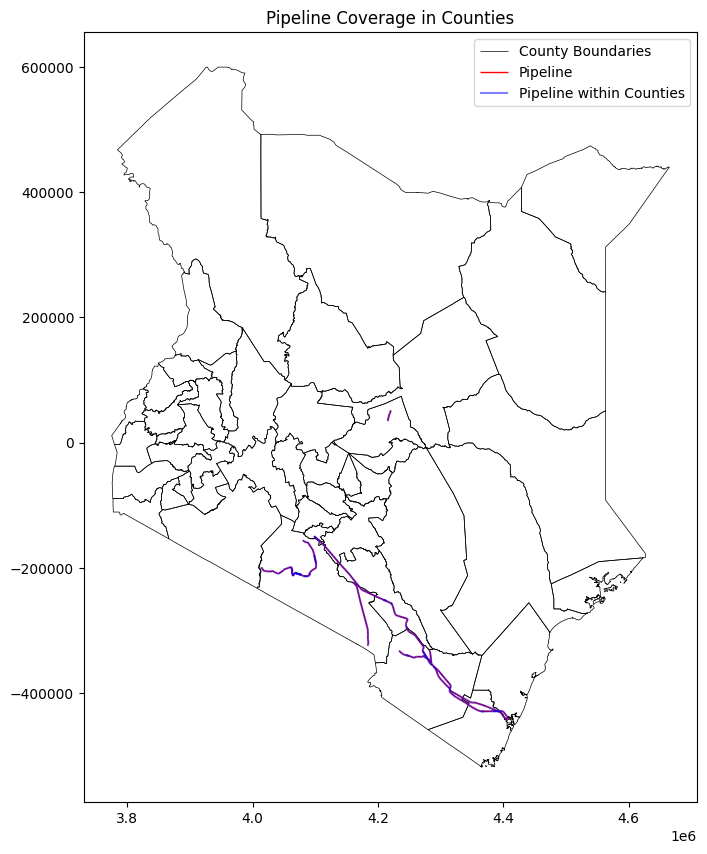

In [171]:
#map showing pipeline passage in each county
fig, ax = plt.subplots(figsize=(12, 10))
kenya_counties.boundary.plot(ax=ax, color="black", linewidth=0.5, label="County Boundaries")
segments_gdf.plot(ax=ax, color="red", linewidth=1, label="Pipeline")
intersections.plot(ax=ax, color="blue", alpha=0.5, label="Pipeline within Counties")
plt.legend()
plt.title("Pipeline Coverage in Counties")
plt.show()

In [172]:
# Check if CRS is in a projected system (e.g., meters)
if not kenya_counties.crs.is_projected:
    kenya_counties = kenya_counties.to_crs(epsg=3395)  # Example: World Mercator projection

    # Project pipeline to the same CRS
    segments_gdf = segments_gdf.to_crs(kenya_counties.crs)
    intersections = intersections.to_crs(kenya_counties.crs)

# Calculate pipeline length in each county
intersections["pipeline_length"] = intersections.geometry.length

# Summarize results by county
pipeline_by_county = intersections.groupby("name").agg({
    "pipeline_length": "sum"
}).reset_index()

# Optionally, merge with original counties for completeness
result = kenya_counties.merge(pipeline_by_county, on="name", how="left")

In [173]:
# Calculate percentage coverage
# Calculate pipeline length in each county
intersections["pipeline_length"] = intersections.geometry.length
total_pipeline_length = segments_gdf.geometry.length.sum()  # Total pipeline length
pipeline_by_county = intersections.groupby("name").agg({
    "pipeline_length": "sum"
}).reset_index()
pipeline_by_county["percentage"] = (pipeline_by_county["pipeline_length"] / total_pipeline_length) * 100

In [174]:
pipeline_by_county

,name,pipeline_length,percentage
0,Kajiado,390091.318872,34.531919
1,Kilifi,22146.795970,1.960493
2,Kwale,144464.784588,12.788406
3,Machakos,41592.576541,3.681885
4,Makueni,148519.523696,13.147343
5,Meru,17984.785271,1.592061
6,Mombasa,6127.970406,0.542464
7,Nairobi,18203.055699,1.611383
8,Taita Taveta,340304.647476,30.124671


In [175]:
# Identify counties with highest and lowest coverage
highest_coverage = pipeline_by_county.nlargest(1, "pipeline_length")
lowest_coverage = pipeline_by_county.nsmallest(1, "pipeline_length")

print("Counties with Highest Pipeline Coverage:")
print(highest_coverage)
print("Counties with Lowest Pipeline Coverage:")
print(lowest_coverage)

Counties with Highest Pipeline Coverage:
      name  pipeline_length  percentage
0  Kajiado    390091.318872   34.531919
Counties with Lowest Pipeline Coverage:
      name  pipeline_length  percentage
6  Mombasa      6127.970406    0.542464


**Geographical Distribution:**

- The pipeline spans multiple counties, including urban areas like Nairobi and coastal counties such as Kilifi, Kwale, and Mombasa.

**Counties with Minimal Pipeline Coverage:**

- Mombasa has the shortest pipeline coverage (6,127.97 meters), with a percentage coverage of **0.54%**, followed by Meru (17,984.79 meters).

**Counties with the Longest Pipeline Coverage:**

- Kajiado has the longest pipeline coverage (390,091.30 meters) and highest percentage pipeline coverage with **34%**, followed by Taita Taveta (340,304.65 meters) with **30%**.

###SCATTERPLOT ANALYSING RELATIONSHIP BETWEEN PIPELINE SEGMENTS AND MEAN CURVATURE

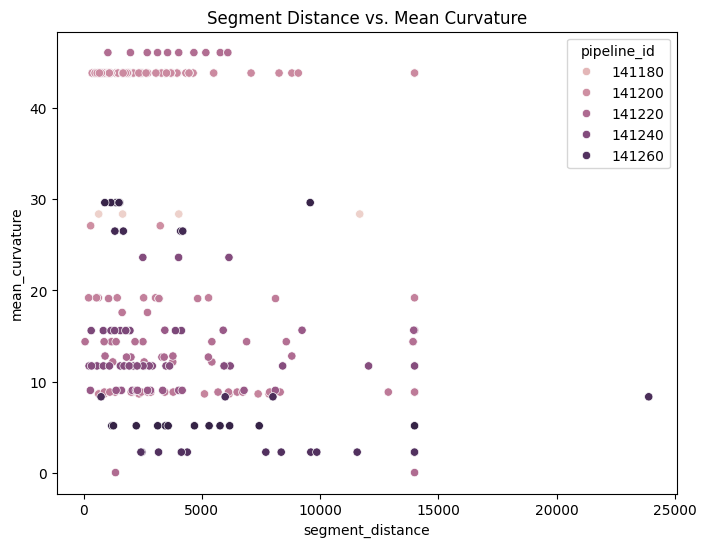

In [199]:
#plotting
plt.figure(figsize=(8, 6))
sns.scatterplot(x='segment_distance', y='mean_curvature', hue='pipeline_id', data=segments_gdf)
plt.title("Segment Distance vs. Mean Curvature")
plt.savefig("dist_vs_curvature.png")




**Insights from the Scatter Plot**
1. Pipeline Design and Stress Points:

- Segments with high mean_curvature are likely to experience higher stress, requiring additional reinforcement or adjustments during construction.
- These segments should be prioritized for analysis, particularly in pipelines with long distances.
2. Pipeline-Specific Variations:

- Different pipelines exhibit varying curvature behaviors, with some pipelines having more consistently low curvature while others show greater variability.
This could be due to differences in terrain, construction methods, or pipeline design.
3. Distance and Curvature Relationship:

- There is no clear trend between segment_distance and mean_curvature, suggesting that curvature is not strongly dependent on the segment's position along the pipeline.

###Comparison Between Above Ground and Underground


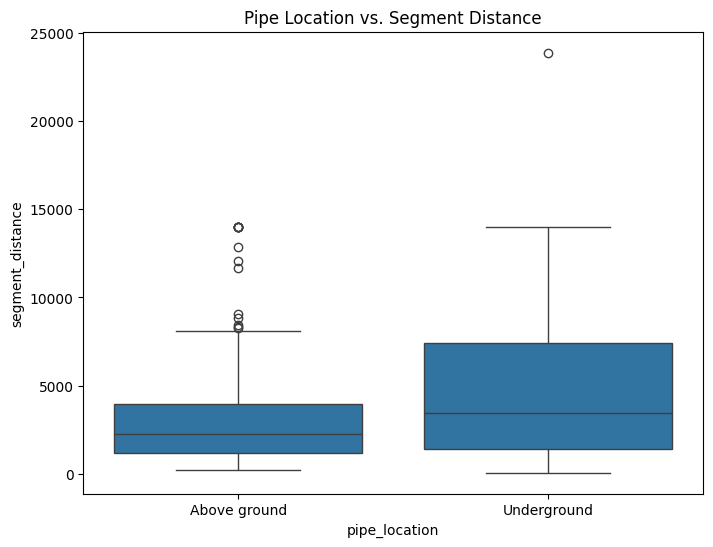

In [201]:
plt.figure(figsize=(8, 6))
sns.boxplot(x='pipe_location', y='segment_distance', data=segments_gdf)
plt.title("Pipe Location vs. Segment Distance")
plt.savefig("pipe_vs_dist.png")






**INSIGHTS**
1. Segment Length - Underground pipeline segments are generally longer than above-ground segments.
2. Variability- Underground segments show greater variability in length (wider IQR) compared to above-ground segments.
3. Outliers - Both categories have outliers, but the underground pipeline has a more extreme outlier (>20,000).

**Implications**
1. Pipeline Design and Construction:

- Underground pipelines tend to have longer segments, which may be due to fewer interruptions (e.g., terrain or environmental factors).
Above-ground pipelines have shorter segments, likely because they require more frequent supports or adjustments to navigate environmental obstacles.
2. Outliers:

- The outliers in both categories should be investigated further, as exceptionally long segments may require special considerations for construction, maintenance, or cost estimation.
3. Cost and Maintenance:

- Longer underground segments may have higher construction costs but fewer maintenance points.
Shorter above-ground segments may require more frequent maintenance due to environmental exposure.

### **Population Impact**
Objective: Overlay population density data to estimate how many people live near the pipeline and identify high-risk areas where pipelines pass through densely populated regions.

In [176]:
urban_settlements = urban_settlements.to_crs(kenya_counties.crs)

# --- 2. Population Impact (Using Alternatives) ---
# Spatial join to find settlements near the pipeline
buffered_pipeline = segments_gdf.copy()
buffered_pipeline["geometry"] = buffered_pipeline.geometry.buffer(1000)  # 1km buffer around the pipeline

# Perform spatial join with urban settlements
population_near_pipeline = gpd.sjoin(urban_settlements, buffered_pipeline, how="inner", predicate="intersects")

# Use 'settlement_count' to estimate population impact
population_near_pipeline["estimated_population"] = population_near_pipeline["settlement_count"] * 50  # Assume avg. 50 people per settlement
total_population = population_near_pipeline["estimated_population"].sum()
print(f"Total Estimated Population Near the Pipeline: {total_population}")





Total Estimated Population Near the Pipeline: 350


In [177]:
#Analyze settlement types (e.g., villages vs towns)
settlement_types = population_near_pipeline.groupby("place_left").agg({
    "settlement_count": "sum",
    "estimated_population": "sum"
}).reset_index()
print("Population Impact by Settlement Type:")
print(settlement_types)

Population Impact by Settlement Type:
  place_left  settlement_count  estimated_population
0       town                 0                     0
1    village                 7                   350


**Total Estimated Population Near the Pipeline: 350** and Majority of those settlements are **Villages**

###**Distribution of Risk to Settlements**

In [178]:
# Identify high-risk areas using 'population_risk' or settlement types
high_risk_areas = population_near_pipeline[population_near_pipeline["population_risk"] != "Low"]
print("High-Risk Areas (Based on Population Risk):")
print(high_risk_areas[["name", "population_risk", "settlement_count", "dist_to_pop"]])



High-Risk Areas (Based on Population Risk):
                      name population_risk  settlement_count  dist_to_pop
379                 Maungu         Minimal                 0   846.181335
392               Miasenyi         Minimal                 0   325.695648
767               Kativani         Minimal                 0   394.664062
768                  Miami         Minimal                 0   394.664062
4828                Samuli         Minimal                 0   200.710632
4931               Kajiado         Minimal                 0   639.068237
4931               Kajiado         Minimal                 0   788.115967
4960             Kitengela         Minimal                 0   879.185364
4988             Mbirikani         Minimal                 0   720.917053
6377                 Rabai         Minimal                 0   306.478607
6377                 Rabai         Minimal                 0   263.255035
7875                 Tsavo         Minimal                 0   938.8

In [179]:
population_near_pipeline["population_risk"].value_counts()

,count
population_risk,
Minimal,49
Low,7


Majority of the Settlements are at a **"*safe distance*"** from the pipeline thus are at **Minimal Risk**

**Some Arears Considered to be at Risk**

In [180]:
unique_high_risk_areas = high_risk_areas[['name', 'dist_to_pop']].drop_duplicates()

# Print the result
print(unique_high_risk_areas)

                      name  dist_to_pop
379                 Maungu   846.181335
392               Miasenyi   325.695648
767               Kativani   394.664062
768                  Miami   394.664062
4828                Samuli   200.710632
4931               Kajiado   639.068237
4931               Kajiado   788.115967
4960             Kitengela   879.185364
4988             Mbirikani   720.917053
6377                 Rabai   306.478607
6377                 Rabai   263.255035
7875                 Tsavo   938.860168
7880                Thange   654.430115
8010               Mazeras   561.915771
8010               Mazeras   602.177429
8010               Mazeras   716.371521
8027                Maikuu   654.430115
8027                Maikuu   818.028259
8075              Kavyongo   654.430115
8075              Kavyongo   818.028259
8097        Kambi ya Munyu   674.878906
8097        Kambi ya Munyu   188.648544
8099               Kandolo   452.211792
8229               Achivwa   981.065063


**Visualizing Settlements at Low Risk areas along Pipeline**

<ipython-input-181-6bc01fb2b0d7>:8: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  plt.legend()


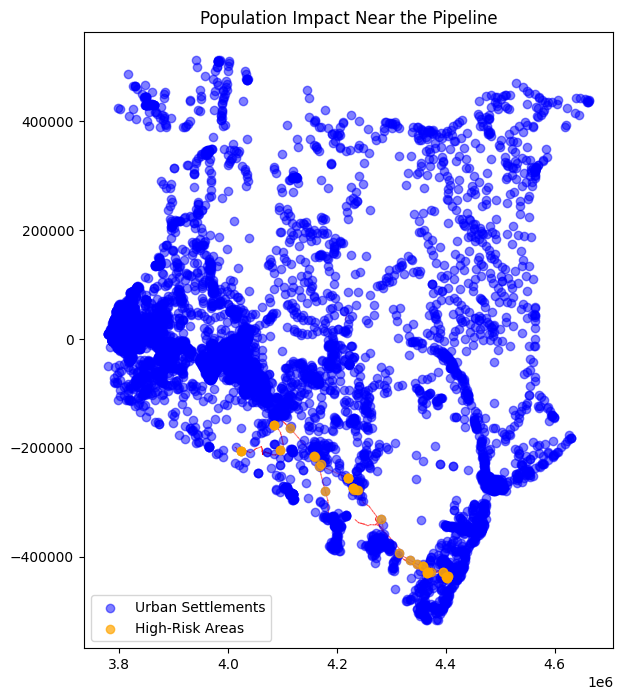

In [181]:
# Visualization: Visualize high-risk areas near the pipeline
import matplotlib.pyplot as plt

fig, ax = plt.subplots(figsize=(12, 8))
buffered_pipeline.plot(ax=ax, color="red", alpha=0.5, label="Pipeline Buffer (1km)")
urban_settlements.plot(ax=ax, color="blue", alpha=0.5, label="Urban Settlements")
high_risk_areas.plot(ax=ax, color="orange", alpha=0.7, label="High-Risk Areas")
plt.legend()
plt.title("Population Impact Near the Pipeline")
plt.show()

###**EFFECTS OF PIPELINE ON ECOLOGICAL SITES**

Plotting map showing Interaction between Pipeline and Ecological Sites in Kenya


In [182]:
from folium import GeoJson
#  Create base Folium map
m = folium.Map(
    location=[0.5, 37.5],
    zoom_start=3,
    min_zoom=5,
    max_zoom=6,
    tiles="CartoDB positron",
    max_bounds=True
)
m.fit_bounds([[-5, 33], [6, 42]])

# Define color style function for pipelines
def pipeline_color(feature):
    return 'red' if feature['properties']['pipe_location'] == 'Above ground' else 'yellow'

# Add pipeline layer
folium.GeoJson(
    segments_gdf,
    style_function=lambda feature: {
        'color': pipeline_color(feature),
        'weight': 2,
        'opacity': 0.7
    },
    tooltip=folium.GeoJsonTooltip(
        fields=['pipeline_id', 'pipe_location', 'segment_distance'],
        aliases=['Pipeline ID:', 'Location:', 'Distance (m):'],
        localize=True
    ),
    name='Pipelines'
).add_to(m)

#  Load and style ecological layers

def ecological_style(feature):
    return {'fillColor': 'green', 'color': 'green', 'weight': 1, 'fillOpacity': 0.3}

def forest_style(feature):
    return {'fillColor': 'blue', 'color': 'green', 'weight': 1, 'fillOpacity': 0.3}

def conserve_style(feature):
    return {'fillColor': 'purple', 'color': 'purple', 'weight': 1, 'fillOpacity': 0.3}

def waterway_style(feature):
    water_type = feature['properties'].get('waterway', '').lower()
    if water_type == 'river':
        color = 'blue'
    elif water_type == 'dam':
        color = 'gray'
    else:
        color = 'orange'
    return {
        'color': color,
        'weight': 1.5,
        'opacity': 0.8
    }



ecological_layer = folium.FeatureGroup(name='National Parks')
forest_layer = folium.FeatureGroup(name='Forest Reserves')
conserve_layer = folium.FeatureGroup(name='Conservancies')
waterway_layer=folium.FeatureGroup(name='Waterways')

GeoJson(
    waterways,
    style_function=waterway_style,
    tooltip=folium.GeoJsonTooltip(
        fields=['name', 'waterway'],
        aliases=['Name:', 'Type:'],
        localize=True
    )
).add_to(waterway_layer)

GeoJson(ecological, style_function=ecological_style).add_to(ecological_layer)
GeoJson(for_reserves, style_function=forest_style).add_to(forest_layer)
GeoJson(conservancy_gdp, style_function=conserve_style).add_to(conserve_layer)

# Add layers to the map
ecological_layer.add_to(m)
forest_layer.add_to(m)
conserve_layer.add_to(m)
waterway_layer.add_to(m)



def county_style(feature):
    return {
        'fillColor': '#ffffff00',  # fully transparent fill
        'color': '#666666',        # soft grey borders
        'weight': 0.5,             # thinner lines
        'opacity': 0.5,            # subtle appearance
        'dashArray': '2, 4'        # optional, finer dash
    }


folium.GeoJson(
    kenya_counties,
    name="Counties",
    style_function=county_style,
    tooltip=folium.GeoJsonTooltip(
        fields=['name'],  # Change to actual field name if different
        aliases=['County:']
    )
).add_to(m)

# Step 10: Add Layer Control
folium.LayerControl(collapsed=False).add_to(m)

# Step 11: Display the map
m


Pipeline and National Parks

1. Length (in Kilometres) of Pipeline in National Parks

In [183]:
# Ensure both GeoDataFrames have the same CRS
segments_gdf = segments_gdf.to_crs(ecological.crs)

# --- 1. Spatial Intersection ---
# Find pipeline segments intersecting with national parks
pipeline_in_parks = gpd.overlay(segments_gdf, ecological, how="intersection")

# Re-project the GeoDataFrame to a projected CRS for accurate length calculation
projected_crs = "EPSG:3857"  # Example of a projected CRS (Web Mercator)
pipeline_in_parks = pipeline_in_parks.to_crs(projected_crs)

# Calculate the length of pipeline segments within each national park
pipeline_in_parks["pipeline_length(km)"] = pipeline_in_parks.geometry.length / 1000

# Print the results
print("Pipeline Segments Intersecting National Parks:")
print(pipeline_in_parks[["NAME", "pipeline_length(km)"]])

Pipeline Segments Intersecting National Parks:
            NAME  pipeline_length(km)
0   Ngai Ndethia             0.046449
1   Ngai Ndethia             1.254609
2     Tsavo East             0.553352
3     Tsavo East             3.545221
4     Tsavo East             1.327326
5     Tsavo East             2.035659
6     Tsavo East             0.586812
7     Tsavo East             9.279493
8     Tsavo East             3.453169
9     Tsavo East            14.073416
10    Tsavo East            14.040005
11    Tsavo East             5.949858
12    Tsavo East             0.288907
13    Tsavo East             1.593402
14    Tsavo East             8.146966
15    Tsavo East             4.042044
16    Tsavo East             2.842014
17    Tsavo East             0.540359
18    Tsavo East             1.105429
19    Tsavo East             2.724645
20    Tsavo East             6.834969
21    Tsavo East             2.240771
22    Tsavo East             2.293601
23    Tsavo East             1.382500
24 

In [184]:
projected_crs = "EPSG:32636"  # Universal Transverse Mercator Zone 36N

# Re-project both GeoDataFrames to the projected CRS
segments_gdf = segments_gdf.to_crs(projected_crs)
ecological = ecological.to_crs(projected_crs)

# --- 1. Spatial Intersection and Pipeline Length in Parks ---
# Find pipeline segments intersecting with national parks
pipeline_in_parks = gpd.overlay(segments_gdf, ecological, how="intersection")

# Calculate length of pipeline segments within parks
pipeline_in_parks["pipeline_length"] = pipeline_in_parks.geometry.length

# Group by park name and calculate total pipeline length in each park
pipeline_impact_by_park = pipeline_in_parks.groupby("NAME").agg({
    "pipeline_length": "sum"
}).reset_index()

# Merge with park data to calculate percentage coverage
ecological["park_boundary_length"] = ecological.geometry.length  # Use boundary or area as needed
park_coverage = pipeline_impact_by_park.merge(
    ecological[["NAME", "park_boundary_length"]], on="NAME"
)

# Calculate percentage coverage for each park
park_coverage["percentage_coverage"] = (
    park_coverage["pipeline_length"] / park_coverage["park_boundary_length"]
) * 100

In [185]:
park_coverage

,NAME,pipeline_length,park_boundary_length,percentage_coverage
0,Nairobi,19516.768068,64127.508217,30.434315
1,Nairobi,19516.768068,19504.117012,100.064864
2,Ngai Ndethia,1296.253761,90337.979176,1.434893
3,Tsavo East,90498.612945,525193.191586,17.231490


- **Pipe length is in Metres**, park_boundary_length also in **Metres** represents The total boundary length of the park (in meters) derived from the perimeter of the park's polygon geometry.
1. Tsavo East:

- Pipeline Length passing through the National Park is 90,498.61 meters (~90.5 km).
- Park Boundary Length: 525,193.19 meters (~525.2 km).
- Percentage Coverage: 17.23%. This indicates a moderate impact of pipelines on the park's boundary.

2. Ngai Ndethia:

- Pipeline Length: 1,296.25 meters (~1.3 km).
- Park Boundary Length: 90,337.98 meters (~90.3 km).
- Percentage Coverage: 1.43%. The impact of pipelines on this park is minimal, as only a small fraction of its boundary is affected.

3. Nairobi National Park (Row 0):

- Pipeline Length: 19,516.77 meters (~19.5 km) of pipeline intersect the park.
- Park Boundary Length: 64,127.51 meters (~64.1 km).
- Percentage Coverage: 30.43% of the park's boundary length is affected by pipelines. This indicates a significant impact of pipelines on the park's boundary.

**Impact**

- High Impact: Nairobi National Park has the highest percentage coverage (30.43% ), suggesting that a significant portion of its boundary is affected by pipelines. This could pose ecological risks to this park.
- Moderate Impact: Tsavo East has a pipeline coverage of 17.23%, which is considerable given the park's large boundary.
- Low Impact: Ngai Ndethia has minimal pipeline presence, with only 1.43% of its boundary affected.

<ipython-input-186-848df743044e>:6: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  plt.legend()


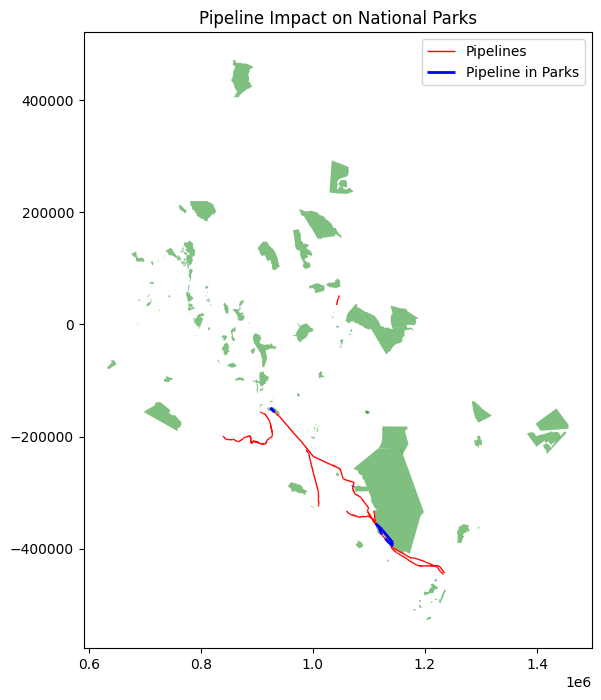

In [186]:

#visualize
fig, ax = plt.subplots(figsize=(12, 8))
ecological.plot(ax=ax, color="green", alpha=0.5, label="National Parks")
segments_gdf.plot(ax=ax, color="red", linewidth=1, label="Pipelines")
pipeline_in_parks.plot(ax=ax, color="blue", linewidth=2, label="Pipeline in Parks")
plt.legend()
plt.title("Pipeline Impact on National Parks")
plt.show()

#**4.MODELLING**

In [187]:
segments_gdf = gpd.read_file("/content/drive/MyDrive/Capstone Project/segments_gdf.gpkg")
segments_gdf.dtypes

,0
pipeline_id,int64
pipe_location,object
segment_distance,float64
angle_segments,float64
sharp_bend,bool
mean_curvature,float64
max_curvature,float64
std_curvature,float64
start_elevation,int16
end_elevation,int16


In [188]:
segments_gdf.head(10)

,pipeline_id,pipe_location,segment_distance,angle_segments,sharp_bend,mean_curvature,max_curvature,std_curvature,start_elevation,end_elevation,...,within_row,road_risk,risk_score,settlement_count,dist_to_pop,place,nearest_settlement_type,population_risk,compliant,geometry
0,141167,Above ground,11670.927717,NaN,False,28.372436,44.984188,20.117647,1485,1290,...,False,Low,0.0,0,6997.475586,town,town,Minimal,True,"LINESTRING (374035.932 10034685.62, 376683.922..."
1,141167,Above ground,1648.939695,-40.069480,False,28.372436,44.984188,20.117647,1290,1269,...,False,Low,0.0,0,7399.514160,hamlet,hamlet,Minimal,True,"LINESTRING (376683.922 10046052.181, 378003.99..."
2,141167,Above ground,637.647528,44.984188,False,28.372436,44.984188,20.117647,1269,1222,...,False,Low,0.0,0,6765.038086,hamlet,hamlet,Minimal,True,"LINESTRING (378003.993 10047040.317, 378094.23..."
3,141167,Above ground,4023.061024,0.063638,False,28.372436,44.984188,20.117647,1222,1118,...,False,Low,0.0,0,2796.602051,hamlet,hamlet,Minimal,True,"LINESTRING (378094.23 10047671.547, 378667.979..."
4,141200,Underground,3239.585203,NaN,False,27.087673,27.087673,NaN,1547,1561,...,False,Low,0.0,0,7111.421875,town,town,Minimal,True,"LINESTRING (264853.662 9843375.296, 267224.488..."
5,141200,Underground,297.600414,-27.087673,False,27.087673,27.087673,NaN,1561,1575,...,False,Low,0.0,0,6864.602051,town,town,Minimal,True,"LINESTRING (267224.488 9841167.56, 267326.041 ..."
6,141202,Above ground,1082.997529,NaN,False,43.834428,161.561986,37.419034,840,762,...,False,Low,0.0,0,1714.843750,village,village,Minimal,True,"LINESTRING (171561.663 9800577.906, 172591.252..."
7,141202,Above ground,2327.591155,-45.346889,True,43.834428,161.561986,37.419034,762,702,...,False,Low,0.0,0,1813.051514,village,village,Minimal,True,"LINESTRING (172591.252 9800242.004, 174482.23 ..."
8,141202,Above ground,1627.417390,68.542710,True,43.834428,161.561986,37.419034,702,674,...,False,Low,0.0,0,3705.437988,village,village,Minimal,True,"LINESTRING (174482.23 9798884.844, 174578.419 ..."
9,141202,Above ground,3091.960228,-17.598296,False,43.834428,161.561986,37.419034,674,672,...,False,Low,0.0,0,5200.736328,village,village,Minimal,True,"LINESTRING (174578.419 9797260.272, 176902.557..."


In [189]:

segments_gdf.copy()
# Example base cost per meter
base_costs = {
    'Above ground': 1000,   # in USD per meter
    'Underground': 2000
}

segments_gdf['base_cost_per_m'] = segments_gdf['pipe_location'].map(base_costs)
segments_gdf['segment_cost'] = segments_gdf['base_cost_per_m'] * segments_gdf['segment_distance']


In [190]:
segments_gdf['high_risk'] = (
    (~segments_gdf['lake_compliant']) |
    (~segments_gdf['forest_compliant']) |
    (~segments_gdf['park_compliant']) |
    (~segments_gdf['conservancy_compliant'])
).astype(int)
segments_gdf['high_risk'].unique()

array([0, 1])

In [191]:
cols_to_drop = [
    'pipeline_id', 'uid', 'pipe_location', 'intersecting_waterways',
    'lake_intersecting_ids', 'forest_intersecting_ids',
    'park_intersecting_ids', 'conservancy_intersecting_ids',
    'place', 'geometry'
]
model_df = segments_gdf.drop(columns=cols_to_drop)


In [192]:
from sklearn.preprocessing import OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.impute import SimpleImputer

# Automatically identify categorical and numeric features
categorical_cols = X.select_dtypes(include=['object', 'category']).columns.tolist()
numeric_cols = X.select_dtypes(include=['number', 'bool']).columns.tolist()

# Preprocessing for numeric and categorical features
numeric_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='median'))  # Handle missing numeric values
])

categorical_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='most_frequent')),  # Handle missing strings
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])

# Combine preprocessing
preprocessor = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, numeric_cols),
        ('cat', categorical_transformer, categorical_cols)
    ])


NameError: name 'X' is not defined

In [ ]:
!pip install imblearn
from imblearn.over_sampling import RandomOverSampler
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, roc_auc_score



# Assuming 'model_df' is your DataFrame and 'high_risk' is your target variable
X = model_df.drop(columns=['high_risk'])
y = model_df['high_risk']

In [ ]:

# Check class distribution before oversampling
print("Class Distribution Before Oversampling:", y.value_counts())

# Apply RandomOverSampler to balance the dataset
ros = RandomOverSampler(random_state=42)
X_resampled, y_resampled = ros.fit_resample(X, y)

# Check class distribution after oversampling
print("Class Distribution After Oversampling:", y_resampled.value_counts())

In [ ]:

from imblearn.over_sampling import RandomOverSampler #Corrected import statement
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, roc_auc_score
from sklearn.preprocessing import LabelEncoder, OneHotEncoder # Import LabelEncoder, OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.impute import SimpleImputer

# Assuming 'model_df' is your DataFrame and 'high_risk' is your target variable
X = model_df.drop(columns=['high_risk'])
y = model_df['high_risk']

# Check class distribution before oversampling
print("Class Distribution Before Oversampling:", y.value_counts())

# Apply RandomOverSampler to balance the dataset
ros = RandomOverSampler(random_state=42)
X_resampled, y_resampled = ros.fit_resample(X, y)

# Check class distribution after oversampling
print("Class Distribution After Oversampling:", y_resampled.value_counts())

# Now proceed with train_test_split
X_train, X_test, y_train, y_test = train_test_split(X_resampled, y_resampled, stratify=y_resampled, random_state=42)

# Automatically identify categorical and numeric features
categorical_cols = X.select_dtypes(include=['object', 'category']).columns.tolist()
numeric_cols = X.select_dtypes(include=['number', 'bool']).columns.tolist()

# Preprocessing for numeric and categorical features
numeric_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='median'))  # Handle missing numeric values
])

categorical_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='most_frequent')),  # Handle missing strings
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])

# Combine preprocessing
preprocessor = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, numeric_cols),
        ('cat', categorical_transformer, categorical_cols)
    ])

# Fit and transform the data using the preprocessor
X_train = preprocessor.fit_transform(X_train)
X_test = preprocessor.transform(X_test)

# RandomForest with class_weight
clf_rf = RandomForestClassifier(class_weight='balanced', random_state=42)
clf_rf.fit(X_train, y_train)
y_pred_rf = clf_rf.predict(X_test)
y_prob_rf = clf_rf.predict_proba(X_test)[:, 1]

# Logistic Regression with class_weight
clf_lr = LogisticRegression(class_weight='balanced', solver='liblinear')
clf_lr.fit(X_train, y_train)
y_pred_lr = clf_lr.predict(X_test)
y_prob_lr = clf_lr.predict_proba(X_test)[:, 1]

# Evaluation
print("RandomForest:")
print(classification_report(y_test, y_pred_rf))
print("AUC:", roc_auc_score(y_test, y_prob_rf))

print("\nLogistic Regression:")
print(classification_report(y_test, y_pred_lr))
print("AUC:", roc_auc_score(y_test, y_prob_lr))

In [ ]:
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import PolynomialFeatures
from sklearn.metrics import mean_squared_error, r2_score
import xgboost as xgb
import matplotlib.pyplot as plt

# -------------------
# Step 1: Feature Setup
# -------------------
features = [
    'mean_curvature',
    'dist_to_waterway', 'dist_to_pop', 'dist_to_road',
    'lake_dist', 'forest_dist', 'park_dist', 'conservancy_dist'
]
X = segments_gdf[features]
y = segments_gdf['segment_cost']

# -------------------
# Step 2: Handle Missing Values
# -------------------
imputer = SimpleImputer(strategy='mean')
X_imputed = imputer.fit_transform(X)

# -------------------
# Step 3: Train/Test Split
# -------------------
X_train, X_test, y_train, y_test = train_test_split(X_imputed, y, test_size=0.2, random_state=42)

# -------------------
# Step 4: Apply Polynomial Features
# -------------------
poly = PolynomialFeatures(degree=2, include_bias=False)
X_train_poly = poly.fit_transform(X_train)
X_test_poly = poly.transform(X_test)

# -------------------
# Step 5: Log-Transform Target (for skew)
# -------------------
y_train_log = np.log1p(y_train)
y_test_log = np.log1p(y_test)

# -------------------
# Step 6: XGBoost Model Setup
# -------------------
xgb_model = xgb.XGBRegressor(
    objective='reg:squarederror',
    reg_alpha=0.1,
    reg_lambda=0.3,
    learning_rate=0.05,
    n_estimators=300,
    max_depth=6,
    subsample=0.8,
    colsample_bytree=0.8,
    random_state=42
)

# -------------------
# Step 7: Train on Polynomial + Log Target
# -------------------
xgb_model.fit(X_train_poly, y_train_log)

# -------------------
# Step 8: Predict and Inverse Log
# -------------------
y_pred_log = xgb_model.predict(X_test_poly)
y_pred = np.expm1(y_pred_log)

# -------------------
# Step 9: Evaluation
# -------------------
rmse = np.sqrt(mean_squared_error(y_test, y_pred))
r2 = r2_score(y_test, y_pred)

print("Polynomial + Log Target - XGBoost:")
print("RMSE:", rmse)
print("R2 Score:", r2)


In [ ]:
# Apply log1p to handle zero values safely
y_train_log = np.log1p(y_train)
y_test_log = np.log1p(y_test)

xgb_model.fit(X_train, y_train_log)
y_pred_log = xgb_model.predict(X_test)

# Inverse log for evaluation
y_pred = np.expm1(y_pred_log)

print("Log-Transformed Target - XGBoost:")
print("RMSE:", np.sqrt(mean_squared_error(y_test, y_pred)))
print("R2 Score:", r2_score(y_test, y_pred))


In [ ]:
from sklearn.preprocessing import PolynomialFeatures

poly = PolynomialFeatures(degree=2, include_bias=False)
X_poly = poly.fit_transform(X_train)

xgb_model.fit(X_poly, y_train)  # Use original y_train here


In [ ]:
# Step 12: Residual Plot
# -------------------
residuals = y_test - y_pred
plt.figure(figsize=(8, 5))
plt.hist(residuals, bins=30, color='orange', edgecolor='black')
plt.title("Residual Distribution")
plt.xlabel("Prediction Error")
plt.ylabel("Frequency")
plt.grid(True)
plt.show()


In [ ]:
import matplotlib.pyplot as plt

plt.figure(figsize=(8, 6))
plt.scatter(y_test, y_pred, alpha=0.6, color='teal')
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'r--')
plt.xlabel("Actual Segment Cost")
plt.ylabel("Predicted Segment Cost")
plt.title("XGBoost Predictions vs. Actuals")
plt.grid(True)
plt.show()


In [ ]:
# Get proper feature names after polynomial transformation
poly_feature_names = poly.get_feature_names_out(features)

# Convert to DataFrame with correct names
X_train_poly_df = pd.DataFrame(X_train_poly, columns=poly_feature_names)
X_test_poly_df = pd.DataFrame(X_test_poly, columns=poly_feature_names)

# Fit model using the DataFrame (with column names)
xgb_model.fit(X_train_poly_df, y_train_log)

# Plot feature importances with actual feature names
xgb.plot_importance(xgb_model, importance_type='gain', max_num_features=10)
plt.title("Top 10 Feature Importances (by Gain)")
plt.show()


In [ ]:
import joblib

# Save trained XGBoost regressor
joblib.dump(xgb_model, 'xgb_segment_cost_model.pkl')


### Q-LEARNING

In [ ]:
import numpy as np
import random

n_segments = len(segments_gdf)
q_table = np.zeros((n_segments, 2))  # [stay (0), reroute (1)]

alpha = 0.1   # Learning rate
gamma = 0.9   # Discount
epsilon = 0.1 # Exploration rate

# Reward function
def get_reward(i, action):
    row = segments_gdf.iloc[i]
    base_reward = -row['segment_cost']
    penalty = row['mean_curvature'] * 100
    eco_penalty = (
        row['dist_to_waterway'] < 50 or
        row['dist_to_pop'] < 50 or
        row['dist_to_road'] < 50
    ) * 500
    return base_reward - penalty - eco_penalty

# Training
for episode in range(1000):
    state = 0
    while state < n_segments - 1:
        if random.uniform(0, 1) < epsilon:
            action = random.choice([0, 1])
        else:
            action = np.argmax(q_table[state])

        reward = get_reward(state, action)
        next_state = state + 1 if action == 0 else state  # stay vs reroute

        best_future = np.max(q_table[next_state])
        q_table[state, action] += alpha * (reward + gamma * best_future - q_table[state, action])
        state = next_state


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# Example Q-table: shape (n_states, n_actions)
# Replace this with your actual Q-table
# For this example, we'll simulate it
np.random.seed(0)
n_states = 60
q_table = np.random.rand(n_states, 2)
q_table[40:, 1] += 0.5  # simulate learned preference for rerouting later

# Policy: the action with the highest Q-value per state
policy = np.argmax(q_table, axis=1)

# 1. Heatmap of Q-values
plt.figure(figsize=(10, 6))
sns.heatmap(q_table, cmap="YlGnBu", annot=True, fmt=".2f")
plt.title("Q-values per State and Action")
plt.xlabel("Actions (0 = Stay, 1 = Reroute)")
plt.ylabel("Pipeline Segment (State)")
plt.show()

In [ ]:
# 2. Policy plot
plt.figure(figsize=(10, 4))
plt.plot(policy, marker='o', linestyle='--')
plt.title("Q-learning Agent Policy Over Segments")
plt.xlabel("Segment (State)")
plt.ylabel("Chosen Action")
plt.yticks([0, 1], labels=["Stay", "Reroute"])
plt.grid(True)
plt.show()


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# Replace this with your actual Q-table (shape: [n_states, n_actions])
np.random.seed(0)
n_states = 60
q_table = np.random.rand(n_states, 2)
q_table[40:, 1] += 0.5  # simulate learned reroute preference later

q0 = q_table[:, 0]
q1 = q_table[:, 1]
q_diff = q1 - q0
policy = np.argmax(q_table, axis=1)

# 1. Q-value Line Plot for Q(0) and Q(1)
plt.figure(figsize=(12, 5))
plt.plot(q0, label='Q(0) - Stay', color='blue', marker='o')
plt.plot(q1, label='Q(1) - Reroute', color='green', marker='x')
plt.title("Q-values per Segment (State)")
plt.xlabel("Segment (State Index)")
plt.ylabel("Q-value")
plt.legend()
plt.grid(True)
plt.show()



In [ ]:



# 2. Q-value Difference Plot (Preference Strength)
plt.figure(figsize=(12, 4))
plt.plot(q_diff, color='purple', label='Q(1) - Q(0)', marker='s')
plt.axhline(0, color='gray', linestyle='--')
plt.title("Q-value Difference: Reroute vs Stay")
plt.xlabel("Segment (State Index)")
plt.ylabel("Q-value Difference")
plt.legend()
plt.grid(True)
plt.show()

In [ ]:
# If Q-table is a numpy array
#np.save('q_table.npy', q_table)

#convert to DataFrame:

q_table_df = pd.DataFrame(q_table)
q_table_df.to_csv('q_table.csv', index=False)

In [ ]:


# Replace 'clean_new_pipeline.csv' with your actual file name or path
new_pipeline = pd.read_csv("/content/drive/MyDrive/Capstone Project Datasets/segments_gdf_updated_cleaned.csv")

# Show a quick preview
print(new_pipeline.shape)
new_pipeline.head()


In [ ]:


new_pipeline = pd.read_csv("/content/drive/MyDrive/Capstone Project Datasets/segments_gdf_updated_cleaned.csv")
X_eval = new_pipeline[features]


q_table_df = pd.read_csv("/content/q_table.csv")

In [ ]:
n_new_segments = new_pipeline.shape[0]  # Assuming 'new_pipeline' is your loaded dataframe
n_q_states = q_table.shape[0]

# Extend Q-table if new pipeline is longer than trained Q-table
if n_new_segments > n_q_states:
    padding = np.tile(q_table[-1, :], (n_new_segments - n_q_states, 1))
    q_table_extended = np.vstack([q_table, padding])
else:
    q_table_extended = q_table[:n_new_segments]

In [ ]:
policy = np.argmax(q_table_extended, axis=1)
new_pipeline['q_action'] = policy


In [ ]:
stay_count = (policy == 0).sum()
reroute_count = (policy == 1).sum()

print(f"Stay: {stay_count} segments")
print(f"Reroute: {reroute_count} segments")

new_pipeline['q_action'].value_counts()


In [ ]:
import matplotlib.pyplot as plt

fig, ax1 = plt.subplots(figsize=(14, 5))

# Plot Q-learning policy (Stay vs Reroute)
ax1.plot(policy, color='blue', marker='o', linestyle='-', label='Q-learning Action')
ax1.set_ylabel('Q Action (0=Stay, 1=Reroute)', color='blue')
ax1.set_xlabel('Pipeline Segment Index')
ax1.set_yticks([0, 1])
ax1.tick_params(axis='y', labelcolor='blue')
ax1.set_title("Q-learning Policy and Pipeline Segment Cost")

# Create second y-axis to plot cost or another feature (like curvature)
ax2 = ax1.twinx()
ax2.plot(new_pipeline['segment_distance'], color='red', marker='x', linestyle='--', label='Segment Cost')
ax2.set_ylabel('Segment Cost', color='red')
ax2.tick_params(axis='y', labelcolor='red')

# Grid and legend
fig.tight_layout()
plt.grid(True)
plt.show()



In [ ]:
# Merge geometry back into new_pipeline from segments_gdf_updated using 'uid' or appropriate key
# Assuming 'segments_gdf' is your original dataframe, replace it if you have a differently named updated dataframe
# Reset index of new_pipeline and assign 'uid' column
new_pipeline = new_pipeline.reset_index()
new_pipeline = new_pipeline.rename(columns={'index': 'uid'})

new_pipeline_geo = pd.merge(
    new_pipeline,
    segments_gdf[['uid', 'geometry']],  # Use 'segments_gdf' if 'segments_gdf_updated' doesn't exist
    on='uid',
    how='left'
)

# Convert to GeoDataFrame
import geopandas as gpd
new_pipeline_gdf = gpd.GeoDataFrame(new_pipeline_geo, geometry='geometry', crs=segments_gdf.crs)  # Use 'segments_gdf' for crs

In [ ]:
print(new_pipeline_gdf.geometry.type.value_counts())
print(new_pipeline_gdf.geometry.is_empty.sum(), "empty geometries")
new_pipeline_gdf = new_pipeline_gdf.to_crs(epsg=4326)

In [ ]:
import folium
from IPython.display import display

# Reproject if necessary
if new_pipeline_gdf.crs.to_epsg() != 4326:
    new_pipeline_gdf = new_pipeline_gdf.to_crs(epsg=4326)

# Ensure uid and q_action are native Python types
new_pipeline_gdf['uid'] = new_pipeline_gdf['uid'].astype(str)
new_pipeline_gdf['q_action'] = new_pipeline_gdf['q_action'].astype(int)

# Drop empty geometries
new_pipeline_gdf = new_pipeline_gdf[~new_pipeline_gdf.geometry.is_empty]

# Compute map center safely
center = new_pipeline_gdf.geometry.unary_union.centroid

# Create base map
m = folium.Map(location=[center.y, center.x], zoom_start=7)

# Add GeoJSON layer with safe property conversion
folium.GeoJson(
    data=new_pipeline_gdf.__geo_interface__,
    name="Pipeline Segments",
    style_function=lambda feature: {
        'color': 'red' if feature['properties']['q_action'] == 1 else 'green',
        'weight': 4,
        'opacity': 0.8
    },
    tooltip=folium.GeoJsonTooltip(
        fields=['uid', 'q_action'],
        aliases=['Segment ID', 'Q Action'],
        localize=True
    )
).add_to(m)

folium.LayerControl().add_to(m)
display(m)


In [ ]:
import folium
from IPython.display import display
import numpy as np

# Predict segment costs if not already done
if 'predicted_cost' not in new_pipeline_gdf.columns:
    features = ['mean_curvature', 'dist_to_waterway', 'dist_to_pop', 'dist_to_road',
                'lake_dist', 'forest_dist', 'park_dist', 'conservancy_dist']

    X_new = new_pipeline_gdf[features]
    X_new_imputed = imputer.transform(X_new)
    predicted_log_costs = xgb_model.predict(X_new_imputed)
    predicted_costs = np.expm1(predicted_log_costs)
    new_pipeline_gdf['predicted_cost'] = predicted_costs

# Normalize costs for color scaling (optional)
cost_min = new_pipeline_gdf['predicted_cost'].min()
cost_max = new_pipeline_gdf['predicted_cost'].max()

def cost_to_color(cost):
    # Scale color from green (low cost) to red (high cost)
    norm = (cost - cost_min) / (cost_max - cost_min)
    r = int(255 * norm)
    g = int(255 * (1 - norm))
    return f'#{r:02x}{g:02x}00'

# Reproject to EPSG:4326 if needed
if new_pipeline_gdf.crs.to_epsg() != 4326:
    new_pipeline_gdf = new_pipeline_gdf.to_crs(epsg=4326)

# Drop empty geometries
new_pipeline_gdf = new_pipeline_gdf[~new_pipeline_gdf.geometry.is_empty]

# Compute center
center = new_pipeline_gdf.geometry.unary_union.centroid

# Create base map
m = folium.Map(location=[center.y, center.x], zoom_start=7)

# Add pipeline layer colored by cost
folium.GeoJson(
    data=new_pipeline_gdf.__geo_interface__,
    name="Pipeline Segments (Predicted Cost)",
    style_function=lambda feature: {
        'color': cost_to_color(feature['properties']['predicted_cost']),
        'weight': 4,
        'opacity': 0.9
    },
    tooltip=folium.GeoJsonTooltip(
        fields=['uid', 'predicted_cost', 'q_action'],
        aliases=['Segment ID', 'Predicted Cost (USD)', 'Q Action (Compliant=1)'],
        localize=True
    )
).add_to(m)

# OPTIONAL: Highlight Turkana route in bold if available
if 'turkana_route_gdf' in globals():  # Ensure turkana route exists
    if turkana_route_gdf.crs.to_epsg() != 4326:
        turkana_route_gdf = turkana_route_gdf.to_crs(epsg=4326)

    folium.GeoJson(
        data=turkana_route_gdf.__geo_interface__,
        name="Reference Turkana Route",
        style_function=lambda x: {
            'color': 'blue',
            'weight': 5,
            'dashArray': '5, 5',
            'opacity': 1
        },
        tooltip=folium.GeoJsonTooltip(fields=[],
                                      aliases=["Turkana Reference"],
                                      sticky=False)
    ).add_to(m)

folium.LayerControl().add_to(m)
display(m)


In [ ]:
features = X.columns.tolist()  # Save this during training
features

#**RECOMMENDATIONS**
**ECOLOGICAL SITES ANALYSIS**

1.Focus on High-Impact Parks:

- Nairobi National Park and Tsavo East require further analysis to assess the ecological risks posed by pipelines.
- Consider buffer zones around pipelines to evaluate the indirect impact on wildlife corridors and habitats.

2.Conservation Strategies:

- Develop mitigation plans for parks with high pipeline coverage to minimize the ecological impact.
- Collaborate with pipeline operators to ensure environmentally compliant practices.

**CURVATURE ANALYSIS**

3.Pipe Segments with extreme values (e.g., angle_segments <-143° or >161°, max_curvature >161)
- These are critical stress points and should be prioritized for further analysis and design adjustments. These segments may require additional reinforcement or realignment to reduce stress and fatigue
- Segments with high Max Curvature and high Std Curvature (e.g., the outlier in the upper-right corner)
4. Analyze Pipeline-Specific Trends - Examine individual pipelines (e.g., 141180, 141240) to identify pipeline-specific patterns or challenges.
